<a href="https://colab.research.google.com/github/boxfather78/MaV/blob/main/MaV_Summative_Assessment_1_0.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>


# <font color='Orange'> Modelling & Visualisation - Summative Assessment </font> 

---
This Colab workbook is split into 6 parts designed in a modular fashion each covering a part of the objective

[GitHub repository](https://github.com/boxfather78/MaV)

# <font color='Orange'> 1: Data Import, initial EDA and cleansing </font>

### 1.1: Import code libraries and CSV

In [51]:
import pandas as pd
import numpy as np

from google.colab import data_table
data_table.enable_dataframe_formatter()

df1 = pd.read_csv('https://raw.githubusercontent.com/boxfather78/MaV/main/CreditCardDataFinal.csv')
print(df1.shape)
df1.sort_values(["Transaction ID"], ascending=True).head()

(100000, 16)


,Transaction ID,Date,Day of Week,Time,Type of Card,Entry Mode,Amount,Type of Transaction,Merchant Group,Country of Transaction,Shipping Address,Country of Residence,Gender,Age,Bank,Fraud
25167,#2546 884,13-Oct-20,Tuesday,23,MasterCard,CVC,£17,Online,Restaurant,United Kingdom,Russia,United Kingdom,F,60.5,Barclays,0
74516,#2546 895,14-Oct-20,Wednesday,21,Visa,CVC,£28,Online,Gaming,United Kingdom,United Kingdom,United Kingdom,M,49.7,RBS,0
57940,#2546 903,13-Oct-20,Tuesday,19,Visa,CVC,£8,Online,Subscription,United Kingdom,United Kingdom,United Kingdom,M,46.2,Barclays,0
9776,#2546 906,14-Oct-20,Wednesday,9,MasterCard,PIN,£186,ATM,Entertainment,United Kingdom,United Kingdom,United Kingdom,F,51.3,Barclays,0
52568,#2546 920,13-Oct-20,Tuesday,22,Visa,CVC,£86,Online,Children,United Kingdom,United Kingdom,United Kingdom,F,59.6,Monzo,0


### 1.2: Split dataset

Split dataset into test/train datasets. This should be done before significant Exploratory Data Analysis or pre-processing, to avoid data (and therefore knowledge) from the test cell leaking into EDA and pre-processing, potentially biasing analysis and cleansing steps taken (Aurélien Géron, 2019a, p.96).

In [52]:
# Split dataset into predictor/target datasets.
from sklearn.model_selection import train_test_split
x = df1.drop(["Fraud"], axis=1)
print("Feature Dataset contains:", x.columns)
y = pd.DataFrame(df1["Fraud"])
print("Target Dataset contains:", y.columns)

# Create model training and test splits. As we have class imbalance in the model, we will stratify samples.
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size = 0.2, random_state=42, stratify=y)
print("x-train:", x_train.shape)
print("y-train:", y_train.shape)
print("x-test:", x_test.shape)
print("y-test:", y_test.shape)

# Merge together training, test and validation datasets to validate stratification.
df1_train = pd.concat([x_train, y_train], axis=1)
print("df1_train:",df1_train.shape)
df1_test = pd.concat([x_test, y_test], axis=1)
print("df1_test:",df1_test.shape,"\n")

fraud_rate_train = pd.crosstab(index=df1_train["Fraud"], columns="Percent", values=df1_train.index, aggfunc='count', normalize='columns').round(4)*100
fraud_rate_test = pd.crosstab(index=df1_test["Fraud"], columns="Percent", values=df1_test.index, aggfunc='count', normalize='columns').round(4)*100

print("Train Fraud Rate \n", fraud_rate_train, "\n Test Fraud Rate \n", fraud_rate_test)

Feature Dataset contains: Index(['Transaction ID', 'Date', 'Day of Week', 'Time', 'Type of Card',
       'Entry Mode', 'Amount', 'Type of Transaction', 'Merchant Group',
       'Country of Transaction', 'Shipping Address', 'Country of Residence',
       'Gender', 'Age', 'Bank'],
      dtype='object')
Target Dataset contains: Index(['Fraud'], dtype='object')
x-train: (80000, 15)
y-train: (80000, 1)
x-test: (20000, 15)
y-test: (20000, 1)
df1_train: (80000, 16)
df1_test: (20000, 16) 

Train Fraud Rate 
 col_0  Percent
Fraud         
0         92.8
1          7.2 
 Test Fraud Rate 
 col_0  Percent
Fraud         
0         92.8
1          7.2


1.2.1: We have an imbalanced dataset, which is to be expected with Fraud instances, as most transactions are unaffected.
A class imbalance can mean a model improves performance through focusing on the majority class, paying less attention to the minority class. In our case we need to predict the minority class to a high degree of accuracy to ensure the model is fit for purpose.
We will look later at methods to get around this.

### 1.3: Profile Report

In [53]:
# Install latest version of Pandas Profiling
!pip install https://github.com/ydataai/pandas-profiling/archive/master.zip

from pandas_profiling import ProfileReport

# Create profile report, save and view
prof = ProfileReport(df1_train)
prof.to_file(output_file='output.html')
prof

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Using cached https://github.com/ydataai/pandas-profiling/archive/master.zip


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

### 1.4: Check for DUPLICATES
There are duplicates in the Transaction ID variable, but no full row duplicates.

In [54]:
# Add column to validate full column-wise duplication and another column for Transaction ID duplicates
df1_train['Full_duplicate'] = df1_train.duplicated(keep='first')
df1_train['TxnID_duplicate'] = df1_train["Transaction ID"].duplicated(keep='first')

# Create dataframe of duplicates and count Txn IDs
df1_full_dupe = df1_train[(df1_train['Full_duplicate'] == True)]
df1_dupe = df1_train[(df1_train['TxnID_duplicate'] == True)]
print("There are", len(df1_full_dupe), " full duplicates across the file.") # 0 duplicates in file
print("There are", len(df1_dupe), "duplicates in the Transaction ID column") # 2,773 duplicates by Transaction ID in file

There are 0  full duplicates across the file.
There are 2773 duplicates in the Transaction ID column


1.4.1: Explore the Transaction ID duplicates

In [55]:
# Create list of Transaction ID duplicates
dupe_list = df1_dupe["Transaction ID"].tolist()

# Create dataframe of first 5 duplicate Txn IDs and the most frequently occurring Txn ID as shown by profile report, then view all matching records
df1_dupesamp = df1_train[df1_train["Transaction ID"].isin(dupe_list[0:4])]
df2_dupesamp = df1_train[df1_train["Transaction ID"] == "#2617 708"]
df3_dupesamp = df1_dupesamp.append(df2_dupesamp).sort_values(["Transaction ID"], ascending=True) 
df3_dupesamp

,Transaction ID,Date,Day of Week,Time,Type of Card,Entry Mode,Amount,Type of Transaction,Merchant Group,Country of Transaction,Shipping Address,Country of Residence,Gender,Age,Bank,Fraud,Full_duplicate,TxnID_duplicate
40884,#2617 708,13-Oct-20,Tuesday,13,Visa,CVC,£10,Online,Subscription,United Kingdom,United Kingdom,United Kingdom,M,53.9,Halifax,0,False,False
44182,#2617 708,13-Oct-20,Tuesday,18,MasterCard,CVC,£22,Online,Services,Russia,Russia,Russia,M,56.4,Halifax,0,False,True
31680,#2617 708,13-Oct-20,Tuesday,23,MasterCard,CVC,£183,Online,Subscription,United Kingdom,United Kingdom,United Kingdom,F,48.1,Halifax,0,False,True
34877,#2617 708,13-Oct-20,Tuesday,22,MasterCard,CVC,£206,Online,Food,United Kingdom,China,United Kingdom,M,45.6,Lloyds,0,False,True
43633,#2775 342,13-Oct-20,Tuesday,11,MasterCard,PIN,£30,ATM,Restaurant,USA,USA,USA,F,43.4,Barlcays,0,False,False
52077,#2775 342,13-Oct-20,Tuesday,10,MasterCard,CVC,£27,Online,Services,Russia,Russia,Russia,F,52.3,Metro,0,False,True
93561,#3365 909,14-Oct-20,Wednesday,19,MasterCard,CVC,£76,Online,Gaming,United Kingdom,United Kingdom,United Kingdom,M,65.6,HSBC,0,False,False
77610,#3365 909,14-Oct-20,Wednesday,18,Visa,CVC,£22,Online,Subscription,United Kingdom,United Kingdom,United Kingdom,F,56.1,Monzo,0,False,True
20344,#3457 714,13-Oct-20,Tuesday,19,Visa,Tap,£23,POS,Electronics,United Kingdom,United Kingdom,United Kingdom,F,46.4,Metro,0,False,False
42290,#3457 714,14-Oct-20,Wednesday,12,Visa,CVC,£353,Online,Children,United Kingdom,United Kingdom,United Kingdom,M,44.2,Halifax,0,False,True


1.4.2: Duplicate Transaction IDs don't look like duplicate transactions, but could duplicates point to fraud?

In [56]:
# Is a duplicate transaction ID an indicator of Fraud?
fraud_dupe = pd.crosstab(index=df1_dupe["Fraud"], columns="Percent", normalize = "columns").round(4)*100
fraud_rate = pd.crosstab(index=df1_train["Fraud"], columns="Percent", normalize = "columns").round(4)*100
print(fraud_dupe, "\n", fraud_rate)
# Positive fraud rate of duplicates is 7.9% vs. full file rate of 7.2%, so might be worth creating a marker against all duplicated Txn_IDs.

col_0  Percent
Fraud         
0         92.1
1          7.9 
 col_0  Percent
Fraud         
0         92.8
1          7.2


1.4.3: Create new variable indicating that Txn ID is a duplicate

In [57]:
# Create duplicate Transaction ID indicator
df1_train["TxnID_Dup"] = np.where(df1_train["Transaction ID"].isin(dupe_list), 1, 0)

# Drop Full_Duplicate and Txn_ID Duplicate variables from df1_train
df1_train.drop(["Full_duplicate","TxnID_duplicate"], axis=1, inplace=True)
df1_train.head()

,Transaction ID,Date,Day of Week,Time,Type of Card,Entry Mode,Amount,Type of Transaction,Merchant Group,Country of Transaction,Shipping Address,Country of Residence,Gender,Age,Bank,Fraud,TxnID_Dup
74551,#3175 659,13-Oct-20,Tuesday,7,Visa,PIN,£69,ATM,Children,Russia,Russia,United Kingdom,M,40.6,Lloyds,0,0
63789,#2913 418,13-Oct-20,Tuesday,20,MasterCard,PIN,£295,POS,Fashion,United Kingdom,United Kingdom,United Kingdom,F,38.7,Halifax,0,0
73905,#3370 828,14-Oct-20,Wednesday,18,MasterCard,Tap,£9,POS,Restaurant,United Kingdom,United Kingdom,United Kingdom,M,54.0,HSBC,0,0
27944,#3639 312,13-Oct-20,Tuesday,7,Visa,Tap,£7,POS,Products,United Kingdom,United Kingdom,United Kingdom,F,42.0,RBS,0,0
49155,#3594 542,13-Oct-20,Tuesday,13,MasterCard,PIN,£356,ATM,Products,United Kingdom,United Kingdom,United Kingdom,M,28.0,Barlcays,0,0


### 1.5: Check for COMPLETENESS

In [58]:
# We can see missing values in the dataset from the profile report. This is validated here.
print("There are",sum(df1_train.isnull().any(axis=1)),"rows with at least one missing value")
# Validate which columns have missing values
print(df1_train.isna().sum());

There are 16 rows with at least one missing value
Transaction ID            0
Date                      0
Day of Week               0
Time                      0
Type of Card              0
Entry Mode                0
Amount                    5
Type of Transaction       0
Merchant Group            7
Country of Transaction    0
Shipping Address          2
Country of Residence      0
Gender                    3
Age                       0
Bank                      0
Fraud                     0
TxnID_Dup                 0
dtype: int64


In [59]:
# Create dataframe of missing values then check fraud rates across dataset
null_data = df1_train[df1_train.isnull().any(axis=1)]
fraud_null = pd.crosstab(index=null_data["Fraud"], columns="Percent", normalize = "columns").round(4)*100
print(fraud_null)

# Fraud rate is 12.5% where a value is missing, versus 7.2% on full file, meaning transaction is more likely to be fraud if at least one value is missing.

col_0  Percent
Fraud         
0         87.5
1         12.5


In [60]:
# We can also look at Fraud rate against missing values in specific columns
null_data_amount = df1_train[df1_train["Amount"].isnull()]
fraud_null_amount = pd.crosstab(index=null_data_amount["Fraud"], columns="Percent", normalize = "columns").round(4)*100
null_data_merchant = df1_train[df1_train["Merchant Group"].isnull()]
fraud_null_merchant = pd.crosstab(index=null_data_merchant["Fraud"], columns="Percent", normalize = "columns").round(4)*100
null_data_shipping = df1_train[df1_train["Shipping Address"].isnull()]
fraud_null_shipping = pd.crosstab(index=null_data_shipping["Fraud"], columns="Percent", normalize = "columns").round(4)*100
null_data_gender = df1_train[df1_train["Gender"].isnull()]
fraud_null_gender = pd.crosstab(index=null_data_gender["Fraud"], columns="Percent", normalize = "columns").round(4)*100
print("Amount\n", fraud_null_amount,"\n\n", "Merchant Group\n", fraud_null_merchant,"\n\n", "Shipping Address\n",
      fraud_null_shipping,"\n\n", "Gender\n", fraud_null_gender)

# Fraud is present across 40% of cases where Amount is null. 

Amount
 col_0  Percent
Fraud         
0         60.0
1         40.0 

 Merchant Group
 col_0  Percent
Fraud         
0        100.0 

 Shipping Address
 col_0  Percent
Fraud         
0        100.0 

 Gender
 col_0  Percent
Fraud         
0        100.0


1.5.1: Null value treatments
* Filling nulls with an average value for Amount could skew the outcome, since 40% are fraudulent. Zero is another option, as is removal. 
* We can’t impute Merchant Group or Shipping Address accurately. We could just label nulls as unknown, but as the volume is low we will remove.
* Missing gender cannot be imputed accurately without more information. Missing volume is low so drop rows.

In [61]:
# Deal with nulls as shown above - remove rows with missing Genders, Merchant Groups and Shipping Address
df1_train.dropna(how='any', subset=['Gender','Merchant Group','Shipping Address'], inplace=True)

print(df1_train.shape) # 11 records removed
df1_train.head()

(79989, 17)


,Transaction ID,Date,Day of Week,Time,Type of Card,Entry Mode,Amount,Type of Transaction,Merchant Group,Country of Transaction,Shipping Address,Country of Residence,Gender,Age,Bank,Fraud,TxnID_Dup
74551,#3175 659,13-Oct-20,Tuesday,7,Visa,PIN,£69,ATM,Children,Russia,Russia,United Kingdom,M,40.6,Lloyds,0,0
63789,#2913 418,13-Oct-20,Tuesday,20,MasterCard,PIN,£295,POS,Fashion,United Kingdom,United Kingdom,United Kingdom,F,38.7,Halifax,0,0
73905,#3370 828,14-Oct-20,Wednesday,18,MasterCard,Tap,£9,POS,Restaurant,United Kingdom,United Kingdom,United Kingdom,M,54.0,HSBC,0,0
27944,#3639 312,13-Oct-20,Tuesday,7,Visa,Tap,£7,POS,Products,United Kingdom,United Kingdom,United Kingdom,F,42.0,RBS,0,0
49155,#3594 542,13-Oct-20,Tuesday,13,MasterCard,PIN,£356,ATM,Products,United Kingdom,United Kingdom,United Kingdom,M,28.0,Barlcays,0,0


### 1.6: Check for CONFORMITY
* Convert 'Date' to DateTime variable, to support a potential wider dataset in future and/or time series analysis.
* Convert 'Day of Week', 'Type of Card', 'Entry Mode', 'Type of Transaction','Merchant Group','Country of Transaction','Shipping Address','Country of Residence','Bank' into Category variables to make variable contents clear.
* 'Amount' should be a float variable. To convert, we will first remove currency symbol, as all are in GBP.
* While we could change 'Time' to a DateTime variable as well, It is simple enough to interpret as an integer, so leave.

In [62]:
print(df1_train.dtypes)

Transaction ID             object
Date                       object
Day of Week                object
Time                        int64
Type of Card               object
Entry Mode                 object
Amount                     object
Type of Transaction        object
Merchant Group             object
Country of Transaction     object
Shipping Address           object
Country of Residence       object
Gender                     object
Age                       float64
Bank                       object
Fraud                       int64
TxnID_Dup                   int64
dtype: object


In [63]:
# Replace £ signs and convert Amount to a float
df1_train["Amount"] = df1_train["Amount"].replace('£', '', regex=True)
df1_train = df1_train.astype({"Amount": 'float'})
# Convert Object variables into Categorical
df1_train = df1_train.astype({"Day of Week": 'category',"Type of Card": 'category',"Entry Mode":'category',"Type of Transaction":'category',
                  "Merchant Group":'category',"Country of Transaction":'category',"Shipping Address":'category',
                  "Country of Residence":'category',"Bank":'category',"Gender":'category'})

# Convert Date into Datetime variable
df1_train["Date"] = pd.to_datetime(df1_train["Date"])
print(df1_train.dtypes)

Transaction ID                    object
Date                      datetime64[ns]
Day of Week                     category
Time                               int64
Type of Card                    category
Entry Mode                      category
Amount                           float64
Type of Transaction             category
Merchant Group                  category
Country of Transaction          category
Shipping Address                category
Country of Residence            category
Gender                          category
Age                              float64
Bank                            category
Fraud                              int64
TxnID_Dup                          int64
dtype: object


In [64]:
# Validate changes by exploring start of file
df1_train.head()

,Transaction ID,Date,Day of Week,Time,Type of Card,Entry Mode,Amount,Type of Transaction,Merchant Group,Country of Transaction,Shipping Address,Country of Residence,Gender,Age,Bank,Fraud,TxnID_Dup
74551,#3175 659,2020-10-13,Tuesday,7,Visa,PIN,69.0,ATM,Children,Russia,Russia,United Kingdom,M,40.6,Lloyds,0,0
63789,#2913 418,2020-10-13,Tuesday,20,MasterCard,PIN,295.0,POS,Fashion,United Kingdom,United Kingdom,United Kingdom,F,38.7,Halifax,0,0
73905,#3370 828,2020-10-14,Wednesday,18,MasterCard,Tap,9.0,POS,Restaurant,United Kingdom,United Kingdom,United Kingdom,M,54.0,HSBC,0,0
27944,#3639 312,2020-10-13,Tuesday,7,Visa,Tap,7.0,POS,Products,United Kingdom,United Kingdom,United Kingdom,F,42.0,RBS,0,0
49155,#3594 542,2020-10-13,Tuesday,13,MasterCard,PIN,356.0,ATM,Products,United Kingdom,United Kingdom,United Kingdom,M,28.0,Barlcays,0,0


### 1.7: Check for INTEGRITY



In [65]:
# Rerun profile report on updated dataset
prof2 = ProfileReport(df1_train)
prof2.to_file(output_file='output2.html')
prof2

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

/usr/local/lib/python3.7/dist-packages/scipy/stats/stats.py:4812: RuntimeWarning: overflow encountered in long_scalars
  (2 * xtie * ytie) / m + x0 * y0 / (9 * m * (size - 2)))


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

1.7.1 Data Integrity Checks

In [66]:
# VALIDATIONS
# Date - check any issue with removing 2 records from 15/16th October to maintain date integrity
date_check = df1_train.groupby(['Date', 'Fraud'])['Fraud'].count().rename("count")
print("Fraud rate by date: \n", date_check,"\n") 

# Time - view records to understand treatment for 1 value of 24
datetime_check = df1_train[df1_train["Time"] == 24]
print("Records with Time of 24: \n", datetime_check, '\n') # Case is fraudulent, suggest relabelling as 0 to indicate midnight.

# Age - create variable for U18s to view if the Fraud profile is different or whether country of residence might permit u18 to hold credit card
df1_train["Age_lt18"] = np.where(df1_train["Age"] < 18, 'Yes', 'No')
age_check = df1_train.groupby(['Age_lt18', 'Fraud'])['Fraud'].count().rename("count")
age_loc_check = df1_train.groupby(['Country of Residence', 'Age_lt18'])['Fraud'].count().rename("count")
print("Fraud rate by Age of <18: \n", age_check / age_check.groupby(level=0).sum()*100, '\n') # Marginally higher rates of fraud amongst under 18s
print("Country of Residence by Age of <18: \n", age_loc_check, '\n') # Most u18s are indeed in UK 

# Bank - check Fraud rate of 'Barlcays' vs. other banks
bank_check = df1_train.groupby(['Bank', 'Fraud'])['Fraud'].count().rename("count")
print("Fraud rate by bank name: \n", bank_check / bank_check.groupby(level=0).sum()*100,'\n') # A lower rate of Fraud, but clearly a typo that needs correcting

# Day of Week - create unique list of days then create dataframe of values with DoW = Thursday or Friday
dow_list = df1_train["Day of Week"].tolist()
dow_unique = pd.unique(dow_list)
print("Unique list of days:", dow_unique,"\n")
dow_check = df1_train[df1_train["Day of Week"].isin(dow_unique[2:])]
print("All records with Day of week = Thursday or Friday:")
dow_check

Fraud rate by date: 
 Date        Fraud
2020-10-13  0        36853
            1         2994
2020-10-14  0        37380
            1         2760
2020-10-15  1            1
2020-10-16  1            1
Name: count, dtype: int64 

Records with Time of 24: 
       Transaction ID       Date Day of Week  Time Type of Card Entry Mode  \
32446      #2547 017 2020-10-14   Wednesday    24   MasterCard        CVC   

       Amount Type of Transaction Merchant Group Country of Transaction  \
32446   371.0              Online    Electronics                  India   

      Shipping Address Country of Residence Gender   Age      Bank  Fraud  \
32446            India                India      M  57.7  Barclays      1   

       TxnID_Dup  
32446          1   

Fraud rate by Age of <18: 
 Age_lt18  Fraud
No        0        92.804458
          1         7.195542
Yes       0        92.537313
          1         7.462687
Name: count, dtype: float64 

Country of Residence by Age of <18: 
 Country of Res

,Transaction ID,Date,Day of Week,Time,Type of Card,Entry Mode,Amount,Type of Transaction,Merchant Group,Country of Transaction,Shipping Address,Country of Residence,Gender,Age,Bank,Fraud,TxnID_Dup,Age_lt18
75994,#3271 352,2020-10-13,Thursday,16,Visa,Tap,7.0,POS,Products,Russia,Russia,United Kingdom,F,61.1,Metro,1,0,No
96801,#2686 124,2020-10-13,Friday,9,Visa,CVC,21.0,Online,Fashion,United Kingdom,India,United Kingdom,M,39.6,HSBC,0,0,No
20296,#3066 613,2020-10-13,Thursday,10,Visa,PIN,169.0,POS,Fashion,United Kingdom,United Kingdom,United Kingdom,M,48.6,Barclays,0,1,No
48256,#2872 483,2020-10-14,Friday,11,MasterCard,CVC,215.0,Online,Entertainment,USA,USA,USA,F,38.7,Barclays,0,0,No
64255,#2548 251,2020-10-15,Thursday,8,Visa,PIN,243.0,POS,Gaming,United Kingdom,United Kingdom,United Kingdom,M,38.9,Barclays,1,1,No
37546,#2870 052,2020-10-13,Thursday,13,MasterCard,Tap,28.0,POS,Subscription,Russia,Russia,Russia,F,57.6,Monzo,0,0,No
68093,#2983 032,2020-10-14,Friday,15,Visa,CVC,16.0,Online,Electronics,United Kingdom,United Kingdom,United Kingdom,M,49.7,Halifax,0,1,No
64778,#3328 717,2020-10-14,Thursday,16,MasterCard,Tap,18.0,POS,Services,United Kingdom,United Kingdom,United Kingdom,M,41.5,Barclays,0,0,No
10483,#2982 416,2020-10-13,Thursday,7,Visa,PIN,294.0,ATM,Gaming,United Kingdom,United Kingdom,United Kingdom,M,38.6,Barlcays,0,0,No
30844,#2895 855,2020-10-13,Friday,7,Visa,CVC,25.0,Online,Fashion,United Kingdom,United Kingdom,United Kingdom,M,33.4,Monzo,0,0,No


1.7.2 Data Integrity Actions:
* Remove Dates falling outside 13/14th October to maintain data integrity.
* Recode value of 24 to 0, to reflect time of midnight.
* Fill Nans in Amount column with 0, Imputing average doesn’t feel right, given many NaN values were fraudulent.
* Age contains values under 18, with credit cards not allowed for this age group in UK - flag this to stakeholders but leave in to avoid bias.
* Code Day of Week to the correct date, removing Thursday and Friday.
* Recode 'Barlcays' with 'Barclays' as this is an obvious error.


In [67]:
# DATA CLEANSE - carry out changes as suggested in 1.7.1

# Amount - recode our 6 NaNs to 0 and check
df1_train["Amount"] = df1_train["Amount"].replace(np.nan, 0, regex=True)
print("Show new Min value of Amount variable \n", df1_train["Amount"].describe(),"\n") # Min value is now 0.

# Date - 15/16th Oct are both marked as Fraudulent, yet we can't impute a new date. Remove to maintain integrity of dataset which is only supposed to be 13/14th Oct transactions.
df1_train = df1_train.drop(df1_train[(df1_train["Date"] == "2020-10-15") | (df1_train["Date"] ==  "2020-10-16")].index)
date_check2 = df1_train.groupby(['Date','Day of Week'])['Date'].count().rename("count")
print("No more dates of 15/16th in Date column \n", date_check2, "\n") 
print("Two records removed: \n", len(df1_train),"\n") # 2 records removed; only 13/14th Oct remain.

# Time - replace singlevalue of 24 with 0
df1_train["Time"] = df1_train["Time"].replace(24, 0, regex=True)
new_time = df1_train.groupby(['Time'])['Time'].count().rename("count")
print("No more 24 in Time variable \n", new_time,"\n")

# Age - No treatment required, but we will remove the variable that was created for validation
df1_train.drop(["Age_lt18"], axis=1, inplace=True)

# Day of Week - Replace incorrect Days of Week to align with Date.
df1_train["Day of Week"] = np.where(df1_train["Date"] == "2020-10-13", "Tuesday", "Wednesday")
date_check3 = df1_train.groupby(['Date','Day of Week'])['Date'].count().rename("count")
print("No more Thursday/Friday in Day of Week column: \n", date_check3,"\n") # Only Tues/Wed now present in data, aligned to correct dates.

# Bank - Amend 'Barlcays' to 'Barclays'
df1_train["Bank"] = df1_train["Bank"].replace('Barlcays', 'Barclays', regex=True)
bank_check = df1_train.groupby(["Bank"])["Bank"].count().rename("count")
print("No more 'Barlcays' in data: \n", bank_check,"\n") # Barlcays no longer in data.

Show new Min value of Amount variable 
 count    79989.000000
mean       112.778007
std        123.634020
min          0.000000
25%         17.000000
50%         30.000000
75%        209.000000
max        400.000000
Name: Amount, dtype: float64 

No more dates of 15/16th in Date column 
 Date        Day of Week
2020-10-13  Friday             6
            Thursday           4
            Tuesday        39837
            Wednesday          0
2020-10-14  Friday             4
            Thursday           2
            Tuesday            0
            Wednesday      40134
Name: count, dtype: int64 

Two records removed: 
 79987 

No more 24 in Time variable 
 Time
0      407
1      389
2      422
3      432
4      390
5      377
6      402
7     4538
8     4540
9     4452
10    4513
11    4619
12    4593
13    4661
14    4589
15    4604
16    4622
17    4532
18    4470
19    4432
20    4404
21    4464
22    4531
23    4604
Name: count, dtype: int64 

No more Thursday/Friday in Day of Wee

### 1.8: Check for OUTLIERS




In [68]:
# Descriptives for numeric variables
print(df1_train.describe())

               Time        Amount           Age         Fraud     TxnID_Dup
count  79987.000000  79987.000000  79987.000000  79987.000000  79987.000000
mean      14.559316    112.774751     44.997558      0.071937      0.068649
std        5.302701    123.633851      9.954264      0.258385      0.252857
min        0.000000      0.000000     15.000000      0.000000      0.000000
25%       10.000000     17.000000     38.200000      0.000000      0.000000
50%       15.000000     30.000000     44.900000      0.000000      0.000000
75%       19.000000    209.000000     51.700000      0.000000      0.000000
max       23.000000    400.000000     86.100000      1.000000      1.000000


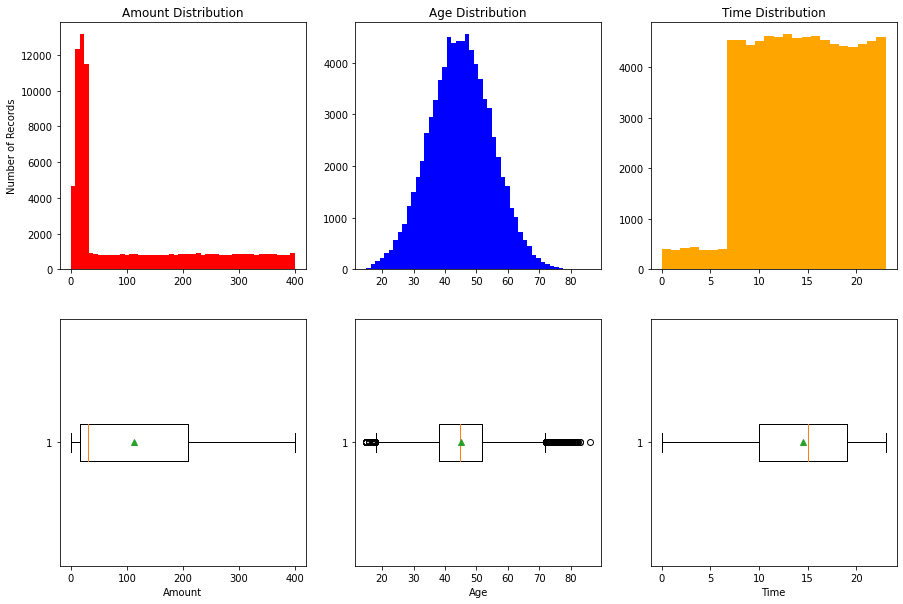

In [69]:
# OUTLIERS - Look at histograms for Time, Amount and Age.
import matplotlib.pyplot as plt #Import matplotlib to show some variable comparisons
%matplotlib inline

# Define series
a = df1_train["Amount"]
b = df1_train["Age"]
c = df1_train["Time"]

# Define canvas size and layout
fig, axs = plt.subplots(2, 3, figsize=(15,10))

# Top level for Histograms
axs[0,0].hist(a,bins=50,histtype='bar',color='red')
axs[0,0].set(title='Amount Distribution', ylabel='Number of Records')
axs[0,1].hist(b,bins=50,histtype='bar',color='blue')
axs[0,1].set(title='Age Distribution')
axs[0,2].hist(c,bins=24,histtype='bar',color='orange') # 24 bins to support hours in day
axs[0,2].set(title='Time Distribution')

# Bottom level for box-plots
axs[1,0].boxplot(a,showmeans=True, vert=False, notch=False)
axs[1,0].set(xlabel='Amount')
axs[1,1].boxplot(b,showmeans=True, vert=False, notch=False)
axs[1,1].set(xlabel='Age')
axs[1,2].boxplot(c,showmeans=True, vert=False, notch=False)
axs[1,2].set(xlabel='Time')

plt.show()

1.8.1: Numeric variable distribution/outlier observations:

- Amount is right-skewed, so mean is £112 vs. a median of £30. Age has a normal distribution with some outliers. Time is left-skewed, due to lower volume of transactions during night hours.
- It's possible that the left and right skewed data might present challenges for certain modelling classes (Wu, 2021).

### 1.9: Save cleansed train dataset for next step.

In [70]:
# Validate columns in df1 dataset
print(df1_train.columns)
# Save dataset while keeping original columns
df1_train.to_csv('CreditCardDataFinalClean.csv', mode='w', index=True)

# Download dataset. This can then be used to continue script from step 2, if desired.
from google.colab import files
files.download('CreditCardDataFinalClean.csv')

Index(['Transaction ID', 'Date', 'Day of Week', 'Time', 'Type of Card',
       'Entry Mode', 'Amount', 'Type of Transaction', 'Merchant Group',
       'Country of Transaction', 'Shipping Address', 'Country of Residence',
       'Gender', 'Age', 'Bank', 'Fraud', 'TxnID_Dup'],
      dtype='object')


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# <font color='Orange'> 2: Further EDA and Feature Variable creation</font>

### 2.1: Re-run profile report

In [71]:
# Only run if starting from stage 2.
!pip install https://github.com/ydataai/pandas-profiling/archive/master.zip
import numpy as np
import pandas as pd
from pandas_profiling import ProfileReport
import matplotlib.pyplot as plt #Import matplotlib to show some variable comparisons
%matplotlib inline

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Using cached https://github.com/ydataai/pandas-profiling/archive/master.zip


In [72]:
# Read in cleansed dataset, drop Transaction ID and set index
df2_train = pd.read_csv('CreditCardDataFinalClean.csv')
df2_train.set_index(df2_train.columns[0], drop=True, inplace=True)
df2_train.index.name = None
df2_train = df2_train.drop("Transaction ID", axis=1)
print(df2_train.head())
print(df2_train.dtypes)

# Rerun profile report on updated dataset
prof3 = ProfileReport(df2_train)
prof3.to_file(output_file='output3.html')
prof3

             Date Day of Week  Time Type of Card Entry Mode  Amount  \
74551  2020-10-13     Tuesday     7         Visa        PIN    69.0   
63789  2020-10-13     Tuesday    20   MasterCard        PIN   295.0   
73905  2020-10-14   Wednesday    18   MasterCard        Tap     9.0   
27944  2020-10-13     Tuesday     7         Visa        Tap     7.0   
49155  2020-10-13     Tuesday    13   MasterCard        PIN   356.0   

      Type of Transaction Merchant Group Country of Transaction  \
74551                 ATM       Children                 Russia   
63789                 POS        Fashion         United Kingdom   
73905                 POS     Restaurant         United Kingdom   
27944                 POS       Products         United Kingdom   
49155                 ATM       Products         United Kingdom   

      Shipping Address Country of Residence Gender   Age      Bank  Fraud  \
74551           Russia       United Kingdom      M  40.6    Lloyds      0   
63789   United K

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

/usr/local/lib/python3.7/dist-packages/scipy/stats/stats.py:4812: RuntimeWarning: overflow encountered in long_scalars
  (2 * xtie * ytie) / m + x0 * y0 / (9 * m * (size - 2)))


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

### 2.2: EDA - Type of Transaction & Entry

The profile report suggests a strong correlation between Amount & Entry Mode and Type of Transaction and Entry Mode.

Percentage of transactions: Type of Transaction vs. Entry Mode 
 Type of Transaction    ATM  Online    POS
Entry Mode                               
CVC                   0.00    33.5   0.00
PIN                  33.33     0.0  16.70
Tap                   0.00     0.0  16.47 

 Average transaction values: Type of Transactions vs. Entry Mode 
 Type of Transaction     ATM  Online     POS
Entry Mode                                 
CVC                     NaN  112.67     NaN
PIN                  112.74     NaN  207.09
Tap                     NaN     NaN   17.47 


AxesSubplot(0.125,0.125;0.775x0.755) 
 AxesSubplot(0.125,0.125;0.775x0.755)


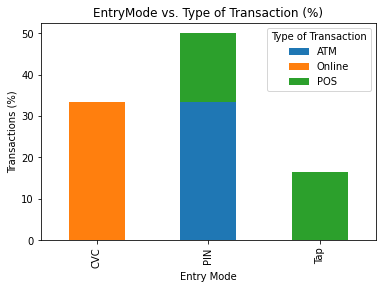

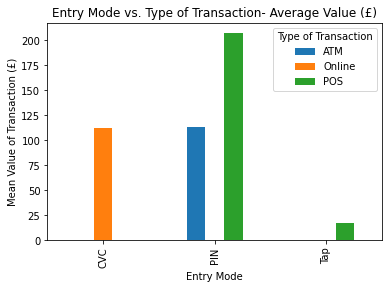

In [73]:
# Look at Type of Transaction vs. Entry Mode to understand inter-dependencies and average spend values for each
ct1 = pd.crosstab(index=df2_train["Entry Mode"], columns=df2_train["Type of Transaction"], values=df2_train.index, aggfunc='count', normalize=True).round(4)*100
ct2 = pd.crosstab(index=df2_train["Entry Mode"], columns=df2_train["Type of Transaction"], values=df2_train["Amount"], aggfunc='mean').round(2)
print("Percentage of transactions: Type of Transaction vs. Entry Mode \n", ct1, '\n\n',
      "Average transaction values: Type of Transactions vs. Entry Mode \n", ct2, '\n\n')

# First chart shows how each Entry Type is split across Type of Transaction 
bar1 = ct1.plot(
    kind='bar', stacked=True, xlabel='Entry Mode',ylabel='Transactions (%)',title="EntryMode vs. Type of Transaction (%)")

# Second chart shows mean value of transactions for entry mode/type of transaction, showing that tap transaction types are restricted by payment limits
bar2 = ct2.round(2).plot(kind='bar', 
                           xlabel='Entry Mode',ylabel='Mean Value of Transaction (£)',title="Entry Mode vs. Type of Transaction- Average Value (£)")

print(bar1, '\n', bar2);

### 2.3: Create Feature - Type Entry
We can create one variable to explain both Type of Transaction and Entry Mode by combining the two variables without losing any information. The impact on Fraud (seen below) shows that the new variable could be significant.

In [74]:
# Create new single variable for Entry Mode/Type of Transaction
df2_train["Type Entry"] = df2_train[["Type of Transaction", "Entry Mode"]].apply("-".join, axis=1)

# Create crosstabs to validate output
check_new_var = pd.crosstab(index=df2_train["Type Entry"], columns='Percent', values=df2_train.index, aggfunc='count', normalize=True).round(4)*100
Type_Entry_Fraud = pd.crosstab(index=df2_train["Type Entry"], columns=df2_train["Fraud"], values=df2_train.index, aggfunc='sum', normalize='index').round(4)*100
print("New Type Entry variable: \n", check_new_var,
      "\n\n New Type Entry variable Fraud likelihood: \n", Type_Entry_Fraud)


New Type Entry variable: 
 col_0       Percent
Type Entry         
ATM-PIN       33.33
Online-CVC    33.50
POS-PIN       16.70
POS-Tap       16.47 

 New Type Entry variable Fraud likelihood: 
 Fraud           0      1
Type Entry              
ATM-PIN     95.16   4.84
Online-CVC  90.55   9.45
POS-PIN     97.17   2.83
POS-Tap     88.77  11.23


### 2.4: EDA - Country of Transaction vs. Shipping Address
How indicative of Fraud is a different Country of Transaction and Shipping Address? Investigate and potentially create some features.



Shipping Address        China  India  Russia   USA  United Kingdom
Country of Transaction                                            
China                    20.5    0.0     0.0   0.0             0.5
India                     0.0   21.1     0.0   0.0             0.5
Russia                    0.0    0.0    20.2   0.0             0.4
USA                       0.0    0.0     0.0  21.4             0.5
United Kingdom            3.8    3.1     3.9   4.3             0.0


<function matplotlib.pyplot.show>

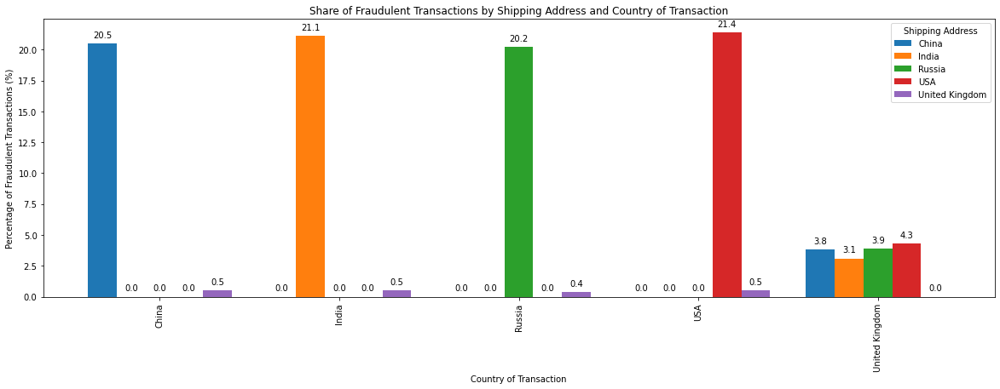

In [75]:
# Create crosstab showing Fraudulent cases split by Country of Transaction vs. Shipping Address
ct2_42 = round(pd.crosstab(index=df2_train["Country of Transaction"], columns=df2_train["Shipping Address"], values=df2_train["Fraud"], aggfunc='sum', 
                               normalize=True),3)*100
print(ct2_42)
# Use crosstab to create bar chart.
bar2_42 = ct2_42.plot(kind='bar', xlabel='Country of Transaction', ylabel='Percentage of Fraudulent Transactions (%)', 
                              title="Share of Fraudulent Transactions by Shipping Address and Country of Transaction", width=0.8, figsize=(20,6))#.legend(bbox_to_anchor=(1, 1))
# Annotate the chart with values
for p in bar2_42.patches:
    bar2_42.annotate(s=round(p.get_height(), 3),
                xy=(p.get_x()+p.get_width()/2., p.get_height()),
                ha='center',
                va='center',
                xytext=(0, 10),
                textcoords='offset points')
plt.show

### 2.5: Create Features: Country similarities
83% of fraudulent transactions occurs when Shipping Address and Country of Transaction are outside UK, with an additional 15% occurring when Country of Transaction is in the UK, but the goods are shipped abroad. We should create feature variables for this.

In [76]:
# Create feature variables for Shipping Address, Country of Transaction and Country of Residence to show where these differ.
df2_train["Ship_Txn_Same"] = np.where(df2_train["Shipping Address"] == df2_train["Country of Transaction"], 1, 0)
df2_train["Ship_Res_Same"] = np.where(df2_train["Shipping Address"] == df2_train["Country of Residence"], 1, 0)
df2_train["Res_Txn_Same"] = np.where(df2_train["Country of Residence"] == df2_train["Country of Transaction"], 1, 0)

# Create filtered dataframe to check output
df2_train_check = df2_train[(df2_train["Ship_Txn_Same"] == 0)]
print(df2_train_check.shape)
print(df2_train_check.dtypes)
df2_train_check.head()

(9618, 20)
Date                       object
Day of Week                object
Time                        int64
Type of Card               object
Entry Mode                 object
Amount                    float64
Type of Transaction        object
Merchant Group             object
Country of Transaction     object
Shipping Address           object
Country of Residence       object
Gender                     object
Age                       float64
Bank                       object
Fraud                       int64
TxnID_Dup                   int64
Type Entry                 object
Ship_Txn_Same               int64
Ship_Res_Same               int64
Res_Txn_Same                int64
dtype: object


,Date,Day of Week,Time,Type of Card,Entry Mode,Amount,Type of Transaction,Merchant Group,Country of Transaction,Shipping Address,Country of Residence,Gender,Age,Bank,Fraud,TxnID_Dup,Type Entry,Ship_Txn_Same,Ship_Res_Same,Res_Txn_Same
55838,2020-10-14,Wednesday,10,Visa,CVC,267.0,Online,Subscription,United Kingdom,USA,United Kingdom,F,37.6,Monzo,0,0,Online-CVC,0,0,1
31067,2020-10-14,Wednesday,10,Visa,PIN,330.0,ATM,Food,United Kingdom,USA,United Kingdom,F,49.8,Barclays,0,0,ATM-PIN,0,0,1
36838,2020-10-13,Tuesday,19,MasterCard,CVC,225.0,Online,Subscription,United Kingdom,India,United Kingdom,F,36.8,Metro,0,0,Online-CVC,0,0,1
37992,2020-10-14,Wednesday,12,Visa,CVC,28.0,Online,Restaurant,United Kingdom,USA,United Kingdom,F,37.5,Barclays,0,0,Online-CVC,0,0,1
77412,2020-10-14,Wednesday,9,MasterCard,PIN,243.0,POS,Restaurant,United Kingdom,USA,United Kingdom,F,44.2,HSBC,0,0,POS-PIN,0,0,1


###2.6: EDA - Merchant Group vs. Fraud
Fraud is highest on Children and Electronics categories.

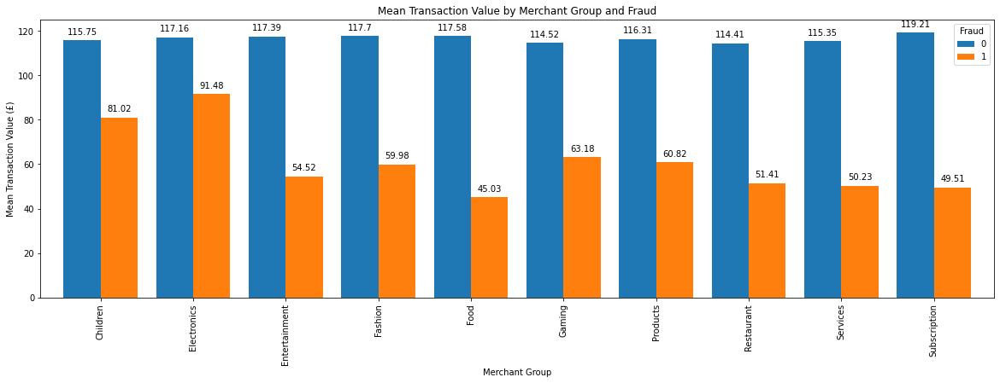

In [77]:
# Create crosstab
ct2_6 = round(pd.crosstab(index=df2_train["Merchant Group"], columns=df2_train["Fraud"], values=df2_train["Amount"], aggfunc='mean', 
                               normalize=False),2)

# Create bar chart from crosstab
bar2_6 = ct2_6.plot(kind='bar', xlabel='Merchant Group', ylabel='Mean Transaction Value (£)',
                              title="Mean Transaction Value by Merchant Group and Fraud", width=0.8, figsize=(20,6))
# Annotate the chart with values
for p in bar2_6.patches:
    bar2_6.annotate(s=round(p.get_height(), 3),
                xy=(p.get_x()+p.get_width()/2., p.get_height()),
                ha='center',
                va='center',
                xytext=(0, 10),
                textcoords='offset points')
plt.show;

2.6.1: Each category makes up roughly 10% of all transactions both in volume and value, but Children and Electronics merchant groups are over-represented for Fraud, pointing to a pattern of behaviour by fraudsters.

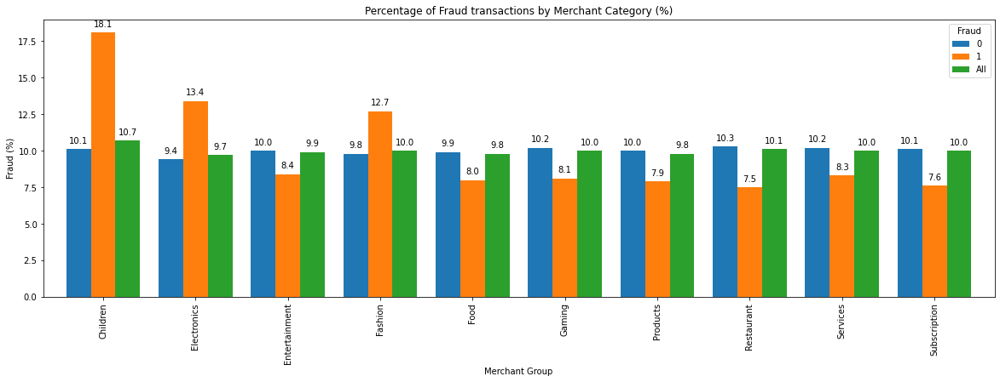

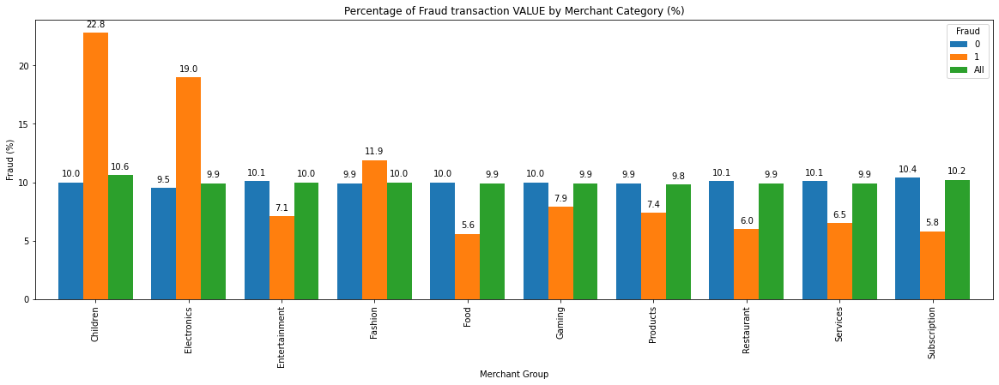

In [78]:
# Create additional crosstab showing fraud volume and value
ct2_61a = round(pd.crosstab(index=df2_train["Merchant Group"], columns=df2_train["Fraud"], values=df2_train.index, aggfunc='count', 
                               normalize='columns', margins=True),3)*100

# Create bar chart from crosstab
bar2_61a = ct2_61a.plot(kind='bar', xlabel='Merchant Group', ylabel='Fraud (%)',
                              title="Percentage of Fraud transactions by Merchant Category (%)", width=0.8, figsize=(20,6))
# Annotate the chart with values
for p in bar2_61a.patches:
    bar2_61a.annotate(s=round(p.get_height(), 3),
                xy=(p.get_x()+p.get_width()/2., p.get_height()),
                ha='center',
                va='center',
                xytext=(0, 10),
                textcoords='offset points')
plt.show;

ct2_61b = round(pd.crosstab(index=df2_train["Merchant Group"], columns=df2_train["Fraud"], values=df2_train["Amount"], aggfunc='sum', 
                               normalize='columns', margins=True),3)*100


# Create bar chart from crosstab
bar2_61b = ct2_61b.plot(kind='bar', xlabel='Merchant Group', ylabel='Fraud (%)',
                              title="Percentage of Fraud transaction VALUE by Merchant Category (%)", width=0.8, figsize=(20,6))
# Annotate the chart with values
for p in bar2_61b.patches:
    bar2_61b.annotate(s=round(p.get_height(), 3),
                xy=(p.get_x()+p.get_width()/2., p.get_height()),
                ha='center',
                va='center',
                xytext=(0, 10),
                textcoords='offset points')
plt.show;


### 2.7: Save output with new feature variables for next step

In [79]:
# Validate columns in df1 dataset
print(df2_train.columns)
# Save dataset while keeping original columns
df2_train.to_csv('CreditCardDataFinalCleanFeatures.csv', mode='w', index=True)

# Download dataset. This can then be used to continute script from step 3, rather than run step 1+2 each time.
from google.colab import files
files.download('CreditCardDataFinalCleanFeatures.csv')

Index(['Date', 'Day of Week', 'Time', 'Type of Card', 'Entry Mode', 'Amount',
       'Type of Transaction', 'Merchant Group', 'Country of Transaction',
       'Shipping Address', 'Country of Residence', 'Gender', 'Age', 'Bank',
       'Fraud', 'TxnID_Dup', 'Type Entry', 'Ship_Txn_Same', 'Ship_Res_Same',
       'Res_Txn_Same'],
      dtype='object')


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

#<font color='Orange'> 3: Data pre-processing and correlation analysis </font>


In [80]:
# Only run cell if starting from stage 3.
import numpy as np
import pandas as pd
from pandas_profiling import ProfileReport
import matplotlib.pyplot as plt #Import matplotlib to show some variable comparisons
%matplotlib inline

In [81]:
# Read in cleansed dataset with new features and set index
df3_train = pd.read_csv('CreditCardDataFinalCleanFeatures.csv')
df3_train.set_index(df3_train.columns[0], drop=True, inplace=True)
df3_train.index.name = "Index"

### 3.1: Explore Correlations
2.1 suggests some strong correlations with Fraud in the Phi-K matrix, a correlation coefficient that works well on categorical data as well as numeric, while exploring non-linear relationships (Baak et al., 2019). 

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
interval columns not set, guessing: ['Time', 'Amount', 'Age', 'Fraud', 'TxnID_Dup', 'Ship_Txn_Same', 'Ship_Res_Same', 'Res_Txn_Same']


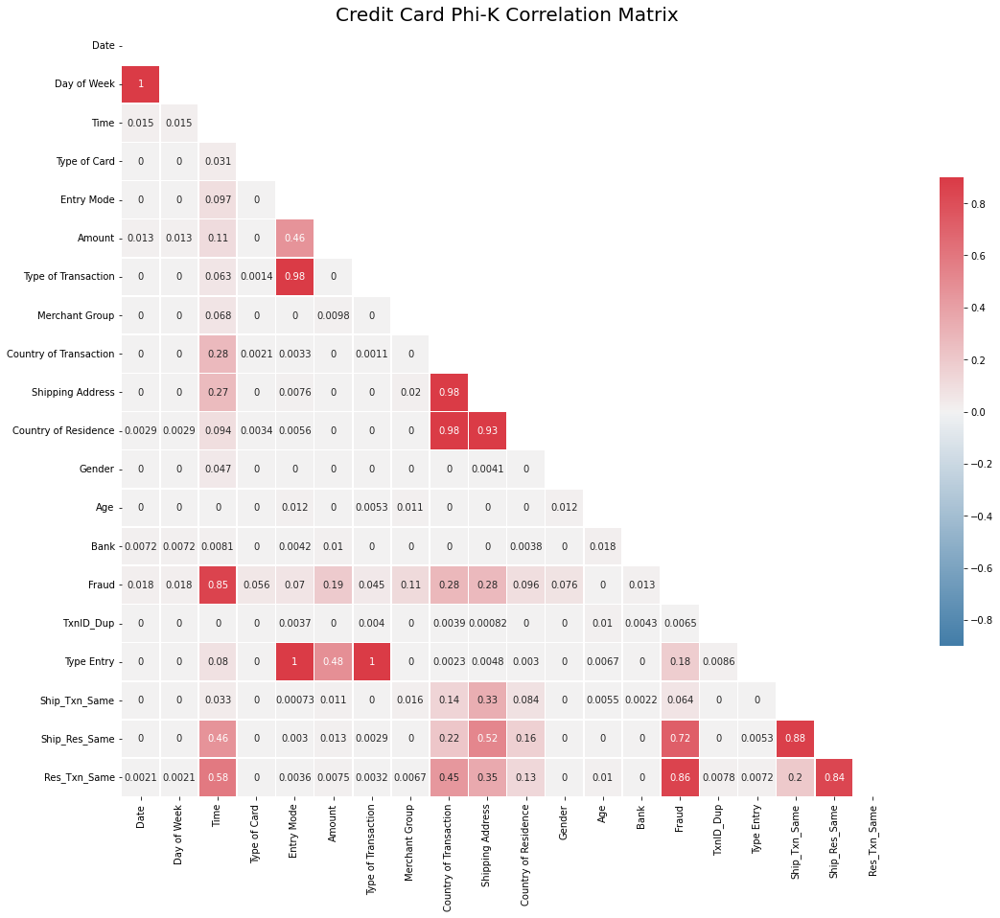

In [82]:
!pip install phik
import seaborn as sns # Import seaborn to create heatmap
import phik
from phik import report

# Use Phi-K and seaborn to create full correlation matrix and a half-heatmap.
corr1 = df3_train.phik_matrix()

# Set up the  figure - large to enable values to be shown
f, ax = plt.subplots(figsize=(18, 18))
plt.title('Credit Card Phi-K Correlation Matrix', fontsize = 20) # title with fontsize 20

# Generate a mask for the upper triangle using triu (replacing with ones)
mask = np.triu(np.ones_like(corr1, dtype=bool))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(240, 10, n=9, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr1, mask=mask, vmin=-0.9, vmax=0.9, cmap=cmap, center=0,
            square=True, linewidths=.5, annot=True, cbar_kws={"shrink": 0.5})
plt.show()

3.1.1: **Correlations Commentary**

The primary correlations with Fraud are:
* Res_Txn_Same
* Time
* Ship_Res_Same
* Country of Transaction
* Shipping Address
* Amount
* Type_Entry

There is also some lower-level correlation between Fraud and...
* Merchant Group
* Country of Residence
* Gender
* Entry Mode

New features created outperform the existing ones
There is multicollinearity between:
* Day of Week vs. Date (Drop both from dataset as we don't have a full set of days/dates to avoid bias on cross-validation)
* Amount vs. Entry Mode (Due to enforced payment limits)
* Type of Transaction vs. Entry Mode (Keep Type_Entry and remove Type of Transaction and Entry Mode)
* Shipping Address vs. Country of Residence vs. Country of Transaction (Keep just Country of Transaction and new transaction location features)
* Time vs. Country of Transaction/Shipping Address and our new features 

**Ethical Considerations**
- Based on regulatory framework and the risk of model bias, I would not include Gender in my model at all.


### 3.2: ENCODE categorical variables
- Encoding caters for string data that machine learning algorithms may struggle to interpret - providing each distinct string value with a numeric value. While Tree-based models will deal well with categorical data, linear or neural network types of model will not (Data Science Stack Exchange, 2018). 
- One Hot Encoding (OHE) is more effective than Label Encoder for categorical data, which will automatically apply an order. OHE can create high dimensionality where the modelling dataset contains a low volume. In this case the categories in each variable are not so high as to impact dimensionality of any model, given our volumes.
- Scaling numeric data will help models to manage variables with large ranges (e.g. Amount/Age), to ensure each has an equal chance to feature in a distance-based classifier (e.g. KNearest Neighbour) and that the importance variables isn't increased artificially due to magnitude of values.
- We will One Hot Encode for object/categorical columns and Min/Max for Numeric columns, which will normalise the numeric data to a value between 0 and 1 using the formula below.

$x'=\frac{x-min(x)}{max(x)-min(x)}$


In [83]:
# Drop correlated and incomplete feature variables as outlined in section 3.1.1
df3_train=df3_train.drop(["Day of Week","Date","Type of Transaction","Entry Mode",
                         "Shipping Address","Country of Residence"], axis=1)
# Check variable types in dataset
print(df3_train.info())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 79987 entries, 74551 to 40477
Data columns (total 14 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Time                    79987 non-null  int64  
 1   Type of Card            79987 non-null  object 
 2   Amount                  79987 non-null  float64
 3   Merchant Group          79987 non-null  object 
 4   Country of Transaction  79987 non-null  object 
 5   Gender                  79987 non-null  object 
 6   Age                     79987 non-null  float64
 7   Bank                    79987 non-null  object 
 8   Fraud                   79987 non-null  int64  
 9   TxnID_Dup               79987 non-null  int64  
 10  Type Entry              79987 non-null  object 
 11  Ship_Txn_Same           79987 non-null  int64  
 12  Ship_Res_Same           79987 non-null  int64  
 13  Res_Txn_Same            79987 non-null  int64  
dtypes: float64(2), int64(6), object(6)

In [84]:
# Define which columns should be encoded
columns_to_encode = df3_train.select_dtypes(include = object).columns.tolist()
print("Columns to encode:", columns_to_encode)

# Create One Hot Encoding using pandas get_dummies
df3_train_OHE = pd.get_dummies(df3_train, columns=columns_to_encode)

# Check completion of encoding
print("\n\n",df3_train_OHE.info(),"\n\n",df3_train_OHE.head())

Columns to encode: ['Type of Card', 'Merchant Group', 'Country of Transaction', 'Gender', 'Bank', 'Type Entry']
<class 'pandas.core.frame.DataFrame'>
Int64Index: 79987 entries, 74551 to 40477
Data columns (total 38 columns):
 #   Column                                 Non-Null Count  Dtype  
---  ------                                 --------------  -----  
 0   Time                                   79987 non-null  int64  
 1   Amount                                 79987 non-null  float64
 2   Age                                    79987 non-null  float64
 3   Fraud                                  79987 non-null  int64  
 4   TxnID_Dup                              79987 non-null  int64  
 5   Ship_Txn_Same                          79987 non-null  int64  
 6   Ship_Res_Same                          79987 non-null  int64  
 7   Res_Txn_Same                           79987 non-null  int64  
 8   Type of Card_MasterCard                79987 non-null  uint8  
 9   Type of Card_Visa     

###3.3: SCALE numeric variables

In [85]:
from sklearn import preprocessing as pp

# Define which columns should be scaled
columns_to_scale  = df3_train_OHE.select_dtypes(include = ['float64','int64'],).columns
print("Columns to scale:", columns_to_scale)

# Initiate Scaler
scaler = pp.MinMaxScaler()

# Create empty list of columns to scale
label_scalers = {}  

# Cycle through columns to scale and transform existing cols.
for column in columns_to_scale:
    label_scalers[column] = scaler
    df3_train_OHE[columns_to_scale] = scaler.fit_transform(df3_train_OHE[columns_to_scale])
    
# Check completion of scaling/encoding
print("\n\n", df3_train_OHE.info(),"\n\n", df3_train_OHE.head())

Columns to scale: Index(['Time', 'Amount', 'Age', 'Fraud', 'TxnID_Dup', 'Ship_Txn_Same',
       'Ship_Res_Same', 'Res_Txn_Same'],
      dtype='object')
<class 'pandas.core.frame.DataFrame'>
Int64Index: 79987 entries, 74551 to 40477
Data columns (total 38 columns):
 #   Column                                 Non-Null Count  Dtype  
---  ------                                 --------------  -----  
 0   Time                                   79987 non-null  float64
 1   Amount                                 79987 non-null  float64
 2   Age                                    79987 non-null  float64
 3   Fraud                                  79987 non-null  float64
 4   TxnID_Dup                              79987 non-null  float64
 5   Ship_Txn_Same                          79987 non-null  float64
 6   Ship_Res_Same                          79987 non-null  float64
 7   Res_Txn_Same                           79987 non-null  float64
 8   Type of Card_MasterCard                79987 non-n

### 3.4: Explore Correlations with additional features


In [86]:
# First we will see which variables carry the highest correlations with Fraud, either positive or negative
correlation1 = abs(df3_train_OHE.corrwith(df3_train_OHE['Fraud'])).sort_values(ascending=False)

print("Correlation Coefficients vs. Fraud:\n", correlation1)

Correlation Coefficients vs. Fraud:
 Fraud                                    1.000000
Res_Txn_Same                             0.654207
Ship_Res_Same                            0.513547
Country of Transaction_United Kingdom    0.345725
Time                                     0.285289
Country of Transaction_India             0.158432
Country of Transaction_USA               0.155190
Country of Transaction_China             0.149945
Country of Transaction_Russia            0.142405
Amount                                   0.108895
Type Entry_POS-PIN                       0.075219
Type Entry_Online-CVC                    0.068195
Type Entry_POS-Tap                       0.067579
Merchant Group_Children                  0.066864
Type Entry_ATM-PIN                       0.061952
Gender_F                                 0.048402
Gender_M                                 0.048402
Ship_Txn_Same                            0.040779
Type of Card_MasterCard                  0.035767
Type of Card_

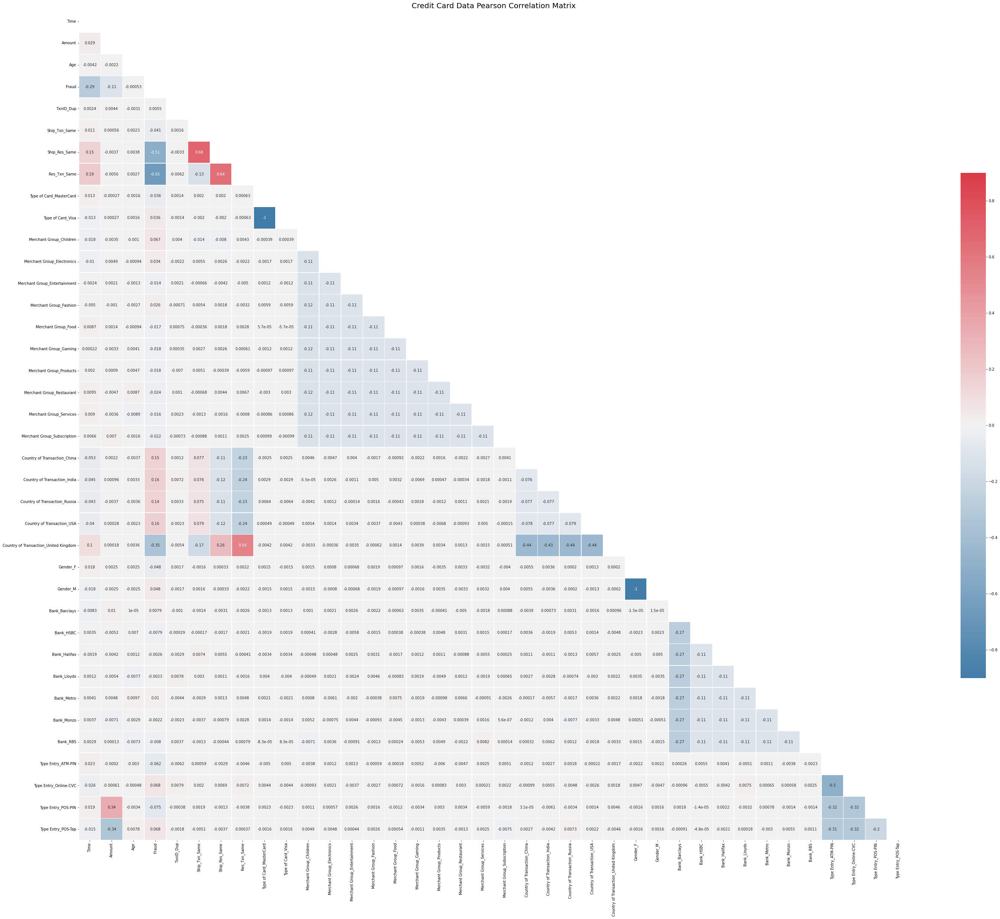

In [87]:
# Use pandas corr and seaborn to create full correlation matrix and a half-heatmap.
correlation2 = df3_train_OHE.corr(method='pearson')

# Set up the  figure - large to enable values to be shown
f, ax = plt.subplots(figsize=(50, 50))
plt.title('Credit Card Data Pearson Correlation Matrix', fontsize = 20) # title with fontsize 20

# Generate a mask for the upper triangle using triu (replacing with ones)
mask = np.triu(np.ones_like(correlation2, dtype=bool))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(240, 10, n=9, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
image = sns.heatmap(correlation2, mask=mask, vmin=-0.9, vmax=0.9, cmap=cmap, center=0,
            square=True, linewidths=0.5, annot=True, cbar_kws={"shrink": 0.5})
plt.show()
figure = image.get_figure()
figure.savefig('pearson.jpg', dpi=400) # Save image for easier viewing

3.4.1: This correlation matrix showing where there is multicollinearity between our new features.

### 3.5: Final Model Feature Variable selection

Based on previous comments, I will drop the following variables from my modelling dataset:
- Gender and Age, to avoid model bias. Date could in future create high dimensionality and is not predictive.
- NB: There is expected multicollinearity between many of my new features, and existing features which have been one-hot encoded. This is known as the 'Dummy Variable Trap'. I will keep all OHE variables but best practice is either to remove one from each encoded variable set for logistic regression, or use Weights of Evidence, since logistic regression assumes feature variables are not correlated (Mahto, 2019),(Lund, 2016).

### 3.6: Final modelling dataset creation


In [88]:
# Create dataframe containing only the variables we will take forward, then re-split into our target and feature variables

df_train_F = df3_train_OHE.drop(['Gender_M','Gender_F','Age','TxnID_Dup'], axis=1)
x_train_F = df_train_F.drop(["Fraud"], axis=1)
y_train_F = pd.DataFrame(df_train_F['Fraud'])

print("Merged Training dataset:\n");
print(df_train_F.info())
print("\n\n Feature variable Training dataset:\n");
print(x_train_F.info())
print("\n\n Target variable Training dataset:\n");
print(y_train_F.info())

Merged Training dataset:

<class 'pandas.core.frame.DataFrame'>
Int64Index: 79987 entries, 74551 to 40477
Data columns (total 34 columns):
 #   Column                                 Non-Null Count  Dtype  
---  ------                                 --------------  -----  
 0   Time                                   79987 non-null  float64
 1   Amount                                 79987 non-null  float64
 2   Fraud                                  79987 non-null  float64
 3   Ship_Txn_Same                          79987 non-null  float64
 4   Ship_Res_Same                          79987 non-null  float64
 5   Res_Txn_Same                           79987 non-null  float64
 6   Type of Card_MasterCard                79987 non-null  uint8  
 7   Type of Card_Visa                      79987 non-null  uint8  
 8   Merchant Group_Children                79987 non-null  uint8  
 9   Merchant Group_Electronics             79987 non-null  uint8  
 10  Merchant Group_Entertainment           7

In [89]:
# Save datasets
df_train_F.to_csv('CreditCardData_Train.csv', mode='w', index=True)
x_train_F.to_csv('CreditCardData_xTrain.csv', mode='w', index=True)
y_train_F.to_csv('CreditCardData_yTrain.csv', mode='w', index=True)

# Download dataset and upload to Github profile. This can then be used to continute script from step 4, rather than run step 1+2+3 each time.
from google.colab import files
files.download('CreditCardData_Train.csv')
files.download('CreditCardData_xTrain.csv')
files.download('CreditCardData_yTrain.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

### 3.7: Create file pre-processing functions for test dataset and future input files

3.7.1: First create cleansing routine function from stage 1.

In [90]:
def process_file(input):
  """Function takes input file matching the layout of train dataset and processes using same criteria as our train dataset, 
  leaving us with a file matching the format"""
  print("############################# Start of process_file function ###################################\n\n")
  # 1.4: DUPLICATES - Only need to check for Full duplicates, as we didn't end up finding significance in duplicated Txn IDs
  input['Full_duplicate'] = input.duplicated(keep='first')
  print("There are", len(input[(input['Full_duplicate'] == True)]), " full duplicates across the file.") # 0 duplicates in file
  input.drop_duplicates(keep='first', inplace=True)
  # 1.5: COMPLETENESS - Find and remove/infill missing values in the test dataset
  print("There are",sum(input.isnull().any(axis=1)),"rows with at least one missing value\n")
  # Validate which columns have missing values
  print(input.isna().sum(),"\n\n")
  # Replace NaN Amounts with £0 first, ahead of reformatting
  input["Amount"] = input["Amount"].replace(np.nan, "£0", regex=True) # Previously done in section 1.7
  # Recode Amount first, then amend following statement to remove all further records with a NaN
  input.dropna(how='any', axis=0, inplace=True)
  # 1.6: CONFORMITY - # Replace £ signs and convert Amount to a float
  input["Amount"] = input["Amount"].replace('£', '', regex=True)
  input = input.astype({"Amount": 'float'})
  # Convert Object variables into Categorical
  input = input.astype({"Day of Week": 'category',"Type of Card": 'category',"Entry Mode":'category',"Type of Transaction":'category',
                  "Merchant Group":'category',"Country of Transaction":'category',"Shipping Address":'category',
                  "Country of Residence":'category',"Bank":'category',"Gender":'category'})
  # Convert Date into Datetime variable
  input["Date"] = pd.to_datetime(input["Date"])
  # 1.7: INTEGRITY - # DATA CLEANSE - carry out changes on test dataset
  # Date - not significant and not used as final modelling var. We previously removed 15/16th Oct but any new dataset is likely to contain new dates so we won't remove 
  # Time - replace 24 with 0
  input["Time"] = input["Time"].replace(24, 0, regex=True)
  # Age - No treatment required, but we will remove the variable that was created for validation
  # Day of Week - Not used as final modelling var, so don't replace incorrect Days of Week
  # Bank - Amend 'Barlcays' to 'Barclays'
  input["Bank"] = input["Bank"].replace('Barlcays', 'Barclays', regex=True)
  print(input.info())
  process_file_out = input
  print("############################# End of process_file function ###################################\n\n")
  return process_file_out

3.7.2: Then create function to add the useful new features

In [91]:
def add_features(process_file_out):
  """Function takes cleansed input file from output of process_file function and creates features using same criteria as our train dataset, 
  leaving us with a file matching the layout"""
  print("############################# Start of add_features function ###################################\n\n")
  # 2.1 Drop unnecessary vars
  process_file_out = process_file_out.drop(['Transaction ID','Full_duplicate'], axis=1)
  # 2.3: Create Type Entry Var and make category
  process_file_out["Type Entry"] = process_file_out[["Type of Transaction", "Entry Mode"]].apply("-".join, axis=1)
  process_file_out["Type Entry"] = process_file_out["Type Entry"].astype('category')
  # 2.5: Create feature variables for Shipping Address, Country of Transaction and Country of Residence to show where these differ.
  process_file_out["Ship_Txn_Same"] = np.where(process_file_out["Shipping Address"] == process_file_out["Country of Transaction"], 1, 0)
  process_file_out["Ship_Res_Same"] = np.where(process_file_out["Shipping Address"] == process_file_out["Country of Residence"], 1, 0)
  process_file_out["Res_Txn_Same"] = np.where(process_file_out["Country of Residence"] == process_file_out["Country of Transaction"], 1, 0)
  print(process_file_out.info())
  print("############################# End of add_features function ###################################\n\n")
  add_features_out = process_file_out
  return add_features_out

3.7.3: Finally, create function to encode and scale variables for modelling

In [92]:
def scale_encode(add_features_out):
  """Function takes cleansed input file with additional features from output of add_features function and encodes/scales 
  using same criteria as our train dataset, then selects final variables, leaving us with a test dataset"""
  print("############################# Start of scale_encode function ###################################\n\n")
  # 3.2: ENCODING
  # Drop correlated feature variables as outlined in section 3.1.1
  add_features_out=add_features_out.drop(["Day of Week","Date", "Type of Transaction","Entry Mode",
                         "Shipping Address","Country of Residence"], axis=1)
  # Define which columns should be encoded
  columns_to_encode = add_features_out.select_dtypes(include='category').columns.tolist()
  print("Columns to encode:", columns_to_encode)
  # Create One Hot Encoding using pandas get_dummies
  add_features_out_OHE = pd.get_dummies(add_features_out, columns=columns_to_encode)
  # Check completion of encoding
  print("View of encoding features: \n\n",add_features_out_OHE.info(),"\n\n",add_features_out_OHE.head())
  # 3.3: SCALING
  from sklearn import preprocessing as pp
  # Define which columns should be scaled
  columns_to_scale  = add_features_out_OHE.select_dtypes(include = ['float64','int64'],).columns
  print("Columns to scale:", columns_to_scale,"\n")
  # Initiate Scaler
  scaler = pp.MinMaxScaler()
  # Create empty list of of columns to scale
  label_scalers = {}  
  # Cycle through columns to scale and transform existing cols.
  for column in columns_to_scale:
    label_scalers[column] = scaler
    add_features_out_OHE[columns_to_scale] = scaler.fit_transform(add_features_out_OHE[columns_to_scale])
  # Check completion of scaling
  print("View of encoded and scaled features: \n\n", add_features_out_OHE.info(),"\n\n", add_features_out_OHE.head())
  # 3.6: Final selections - make available globally (i.e. outside function)
  global df_test_F
  global x_test_F
  global y_test_F
  df_test_F = add_features_out_OHE.drop(['Gender_M','Gender_F','Age'], axis=1)
  x_test_F = df_test_F.drop(["Fraud"], axis=1)
  y_test_F = pd.DataFrame(df_test_F['Fraud'])

  print("Merged Test dataset:\n");
  print(df_test_F.info())
  print("\n\n Feature variable Test dataset:\n");
  print(x_test_F.info())
  print("\n\n Target variable Test dataset:\n");
  print(y_test_F.info())
  print("############################# End of scale_encode function ###################################\n\n")
  return df_test_F, x_test_F, y_test_F

### 3.8: Initiate Functions to create final test datasets

In [93]:
input = df1_test # If steps 1.1 and 1.2 haven't been run in this session, you will need to re-run these first
process_file_out = process_file(input)
add_features_out = add_features(process_file_out)

scale_encode(add_features_out)


############################# Start of process_file function ###################################


There are 0  full duplicates across the file.
There are 7 rows with at least one missing value

Transaction ID            0
Date                      0
Day of Week               0
Time                      0
Type of Card              0
Entry Mode                0
Amount                    1
Type of Transaction       0
Merchant Group            3
Country of Transaction    0
Shipping Address          3
Country of Residence      0
Gender                    1
Age                       0
Bank                      0
Fraud                     0
Full_duplicate            0
dtype: int64 


<class 'pandas.core.frame.DataFrame'>
Int64Index: 19994 entries, 65440 to 22149
Data columns (total 17 columns):
 #   Column                  Non-Null Count  Dtype         
---  ------                  --------------  -----         
 0   Transaction ID          19994 non-null  object        
 1   Date           

(           Time  Amount  Fraud  Ship_Txn_Same  Ship_Res_Same  Res_Txn_Same  \
 65440  0.739130  0.4325    0.0            0.0            0.0           1.0   
 65326  0.695652  0.1050    0.0            1.0            0.0           0.0   
 10802  0.739130  0.0475    0.0            0.0            0.0           1.0   
 79211  0.304348  0.0725    0.0            1.0            1.0           1.0   
 99027  0.565217  0.0750    0.0            0.0            0.0           1.0   
 ...         ...     ...    ...            ...            ...           ...   
 14782  0.695652  0.6700    0.0            1.0            1.0           1.0   
 64241  0.478261  0.1300    0.0            1.0            1.0           1.0   
 7211   0.260870  0.0200    1.0            1.0            0.0           0.0   
 25468  0.521739  0.1525    0.0            1.0            0.0           0.0   
 22149  0.391304  0.2500    0.0            1.0            1.0           1.0   
 
        Type of Card_MasterCard  Type of Card_Visa

In [94]:
# Save datasets
df_test_F.to_csv('CreditCardData_Test.csv', mode='w', index=True)
x_test_F.to_csv('CreditCardData_xTest.csv', mode='w', index=True)
y_test_F.to_csv('CreditCardData_yTest.csv', mode='w', index=True)

# Download dataset. This can then be used to continute script from step 4, rather than run step 1+2+3 each time.
from google.colab import files
files.download('CreditCardData_Test.csv')
files.download('CreditCardData_xTest.csv')
files.download('CreditCardData_yTest.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# <font color='Orange'> 4: Model creation and commentary </font>

SciKitLearn is an established coding library that has been in use since 2007, and has an excellent knowledge base and documentation (Pedregosa et al., 2011). We will also use XGBoost and Keras libraries for further models.

### 4.1: Initiate Train and Test datasets






In [1]:
# Only need to run this section if you are starting from stage 4.
import numpy as np
import pandas as pd

In [95]:
# These steps are necessary if you are starting from section 4.
x_train_F = pd.read_csv('CreditCardData_xTrain.csv') 
x_train_F.set_index(x_train_F.columns[0], drop=True, inplace=True)
x_train_F.index.name = "Index"

y_train_F = pd.read_csv('CreditCardData_yTrain.csv') 
y_train_F.set_index(y_train_F.columns[0], drop=True, inplace=True)
y_train_F.index.name = "Index"

x_test_F = pd.read_csv('CreditCardData_xTest.csv') 
x_test_F.set_index(x_test_F.columns[0], drop=True, inplace=True)
x_test_F.index.name = "Index"

y_test_F = pd.read_csv('CreditCardData_yTest.csv') 
y_test_F.set_index(y_test_F.columns[0], drop=True, inplace=True)
y_test_F.index.name = "Index"

# Start from here without re-defining variables if you are running the script all in one go.
print("Training dataset predictor variables: \n")
print(x_train_F.info(), "\n")
print("Training dataset target variable: \n")
print(y_train_F.info(), "\n")
print("Test dataset predictor variables: \n")
print(x_test_F.info(), "\n")
print("Test dataset target variable: \n")
print(y_test_F.info(), "\n")

Training dataset predictor variables: 

<class 'pandas.core.frame.DataFrame'>
Int64Index: 79987 entries, 74551 to 40477
Data columns (total 33 columns):
 #   Column                                 Non-Null Count  Dtype  
---  ------                                 --------------  -----  
 0   Time                                   79987 non-null  float64
 1   Amount                                 79987 non-null  float64
 2   Ship_Txn_Same                          79987 non-null  float64
 3   Ship_Res_Same                          79987 non-null  float64
 4   Res_Txn_Same                           79987 non-null  float64
 5   Type of Card_MasterCard                79987 non-null  int64  
 6   Type of Card_Visa                      79987 non-null  int64  
 7   Merchant Group_Children                79987 non-null  int64  
 8   Merchant Group_Electronics             79987 non-null  int64  
 9   Merchant Group_Entertainment           79987 non-null  int64  
 10  Merchant Group_Fashion    

### 4.2: Create classifications using training data
Model classes shown below will be used, plus a Dummy Model, which will score everything as 'Not Fraud' to achieve a 92.8% accuracy benchmark.

The train and test datasets have been stratified with class imbalance. This could lead to models not performing well on minority classes. Traditional treatments are undersampling of the majority class or oversampling of the minority class through duplication or creation of synthetic data, neither of which will be readily accepted by a commercial model governance process. Class weight hyper-parameter will be used to improve prediction performance across minority classes. (Solon, Haider and Wooldridge, 2013)

* i. **Logistic Regression** - Common method for binary classification, efficient and easy to interpret. Prone to overfitting with variable multicollinearity or high dimensionality, can't handle non-linear relationships between variables. 
- ii. **Decision Tree Classifier** - Effective at finding non-linear relationships, and frequently used for fraud detection. Can be prone to overfitting.
- iii. **Bagging Classifier** - An ensemble method that fits on random subsets of the training data or features, then takes an average for the final prediction (Kumar, 2021). 
- iv. **Random Forest Classifier** - Ensemble method, multiple Decision Trees are trained using bootstrap aggregation. Splitting randomly and taking an average means it is less prone to overfitting.
- v. **AdaBoost Classifier** - Ensemble method, trains predictors in a step-wise fashion, improving on the previous outcome by focusing on underfitted points in the training dataset. Can work well for imbalanced data but sequential operation doesn't work well for parallel computation like Bagging and Random Forests, since for these each predictor is independent of another (Veronica, 2020). 
- vi. **XGBoost** - Optimised version of Gradient Boosting. Fast and scalable, can use distributed computation effectively. .vii. Artificial Neural Network - Powerful, scalable and widely used in industry for complex use cases. Work well with large data quantities, but require a large amount of computational power.


In [96]:
# Import Scikit Learn libraries, XGBoost for the classifications we'll build
from sklearn.dummy import DummyClassifier 
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import BaggingClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import AdaBoostClassifier
!pip install xgboost
from xgboost import XGBClassifier

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [97]:
# Instantiate each model type. Artificial Neural Network will be added later.

# Dummy - This will predict outcome based on most frequently observed label and is our baseline.
dum = DummyClassifier(strategy="most_frequent")
# Logistic Regression - Default settings
log = LogisticRegression(random_state=1)
# Decision Tree - With settings to decrease potential for overfitting
dt = DecisionTreeClassifier(splitter='best', max_depth=3, max_leaf_nodes=100, min_samples_leaf = 250, random_state=1)
# Bagging Classifier - aiming to improve on Decision Tree, creating 100 different classifiers on 1000 different samples using up to 20 features.
bag = BaggingClassifier(LogisticRegression(random_state=1),
                        n_estimators=100, max_features=20, max_samples=1000, bootstrap=True)
# Random Forest - With settings to decrease potential for overfitting
rf = RandomForestClassifier(max_depth=3, max_leaf_nodes=100, min_samples_leaf = 250, n_estimators=200, random_state=1)
# Ada Boost Classifier - We will train a Decision Tree from the base using 200 estimators, using SAMME.R algorithm, which uses class probabilities to form predictors.
ada = AdaBoostClassifier(DecisionTreeClassifier(max_depth=1), n_estimators=200, algorithm="SAMME.R", random_state=1)
# XGBoost Classifier model with 500 classifiers and early stopping after minimal change in loss metric after 5 rounds
xgb = XGBClassifier(n_estimators=500, early_stopping_round=5, random_state=1)

### 4.3: Fit models to test and train
Function below fits the model to training data and then applies to train; a cross-validation of train; and to test dataset, to see how well each model generalises.
The function will return Logloss, Accuracy, Precision, Recall and F1 scores, plus a classification matrix.  



In [98]:
from sklearn.model_selection import cross_val_score
import sklearn.metrics as met
import pandas as pd

# Function fits and predicts on training dataset, a different sample of the train dataset, and on the test dataset 
def test_val_outputs(model, xtrain, ytrain, xtest, ytest):
  '''This module fits the data to our training dataset, then predicts outcomes against the same dataset, the average of 5 different samples of
  the train dataset (cross validation) and to our test or holdout dataset, returning a series of scores to assess effectiveness.'''
  model.fit(xtrain, np.ravel(ytrain))
  train_y_pred = model.predict(xtrain)
  train_y_prob = model.predict_proba(xtrain)
  test_y_pred = model.predict(xtest)
  test_y_prob = model.predict_proba(xtest)
  
  train_acc = met.accuracy_score(np.ravel(ytrain), np.ravel(train_y_pred)) * 100
  train_pre = met.precision_score(np.ravel(ytrain),np.ravel(train_y_pred)) * 100
  train_rec = met.recall_score(np.ravel(ytrain),np.ravel(train_y_pred)) * 100
  train_f1 = met.f1_score(np.ravel(ytrain),np.ravel(train_y_pred)) * 100
  train_logloss = met.log_loss(np.ravel(ytrain), train_y_prob)
  cv_acc = cross_val_score(model, xtrain, np.ravel(ytrain), cv=5).mean()*100
  cv_logloss = -1*cross_val_score(model, xtrain, np.ravel(ytrain), cv=5, scoring='neg_log_loss').mean()
  test_acc = met.accuracy_score(ytest, test_y_pred) * 100
  test_pre = met.precision_score(np.ravel(ytest),np.ravel(test_y_pred)) * 100
  test_rec = met.recall_score(np.ravel(ytest),np.ravel(test_y_pred)) * 100
  test_f1 = met.f1_score(np.ravel(ytest),np.ravel(test_y_pred)) * 100
  test_logloss = met.log_loss(ytest, test_y_prob)

  print(f"Model: {model}\n")
  print(f"Train Accuracy: {train_acc: .2f}%")
  print(f"Train Precision: {train_pre: .2f}%")
  print(f"Train Recall: {train_rec: .2f}%")
  print(f"Train F1-score: {train_f1: .2f}%")
  print(f"Train Logloss: {train_logloss:.5f}")
  print(f"CV accuracy: {cv_acc: .2f}%")
  print(f"CV logloss: {cv_logloss: .5f}")
  print(f"Test Accuracy: {test_acc:.2f}%")
  print(f"Test Precision: {test_pre: .2f}%")
  print(f"Test Recall: {test_rec: .2f}%")
  print(f"Test F1-score: {test_f1: .2f}%")
  print(f"Test Logloss: {test_logloss:.5f}")
  return train_acc, train_pre, train_rec, train_f1, train_logloss, cv_acc, cv_logloss, test_acc, test_pre, test_rec, test_f1, test_logloss, train_y_pred, test_y_pred

### 4.4: Evaluation metrics
Function below returns confusion matrices. 


In [99]:
# Function creates confusion matrix plot
import matplotlib.pyplot as plt #Import matplotlib to show some variable comparisons
import seaborn as sns # Import seaborn to create heatmap
%matplotlib inline

def conf_mat_plot(y_test, y_pred, model):
    from sklearn.metrics import confusion_matrix
    from sklearn.metrics import classification_report
    mat = confusion_matrix(y_test, y_pred.round())
    names = ["True Negative", "False Positive", "False Negative", "True Positive"]
    counts = ["{0:0.0f}".format(value) for value in mat.flatten()]
    percents = ["{0:.2%}".format(value) for value in mat.flatten()/np.sum(mat)]
    labels = ["{}\n{}\n{}".format(a, b, c) for a, b, c in zip(names, counts, 
                                                                percents)]
    labels = np.asarray(labels).reshape(2,2)
    fig, ax = plt.subplots(figsize=(3,3))
    ax = sns.heatmap(mat, annot=labels, fmt="", cmap="Blues");
    ax.set(xlabel="Predicted", ylabel="Actuals", 
       title='Confusion Matrix of {}'.format(model));

### 4.5: Run Functions to create classification outputs for SciKit Learn models

(DummyClassifier(strategy='most_frequent'), 'Dummy Classifier')


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Model: DummyClassifier(strategy='most_frequent')

Train Accuracy:  92.81%
Train Precision:  0.00%
Train Recall:  0.00%
Train F1-score:  0.00%
Train Logloss: 2.48461
CV accuracy:  92.81%
CV logloss:  2.48461
Test Accuracy: 92.80%
Test Precision:  0.00%
Test Recall:  0.00%
Test F1-score:  0.00%
Test Logloss: 2.48581

               precision    recall  f1-score   support

         0.0       0.93      1.00      0.96     18555
         1.0       0.00      0.00      0.00      1439

    accuracy                           0.93     19994
   macro avg       0.46      0.50      0.48     19994
weighted avg       0.86      0.93      0.89     19994



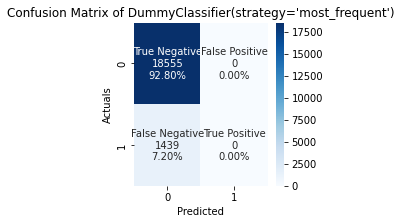

(LogisticRegression(random_state=1), 'Logistic Regression')
Model: LogisticRegression(random_state=1)

Train Accuracy:  97.02%
Train Precision:  81.65%
Train Recall:  75.62%
Train F1-score:  78.52%
Train Logloss: 0.06999
CV accuracy:  97.02%
CV logloss:  0.07028
Test Accuracy: 97.06%
Test Precision:  81.89%
Test Recall:  76.03%
Test F1-score:  78.85%
Test Logloss: 0.06841

               precision    recall  f1-score   support

         0.0       0.98      0.99      0.98     18555
         1.0       0.82      0.76      0.79      1439

    accuracy                           0.97     19994
   macro avg       0.90      0.87      0.89     19994
weighted avg       0.97      0.97      0.97     19994



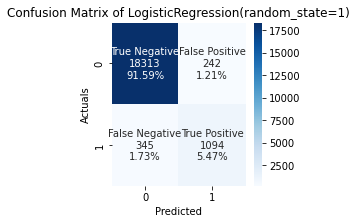

(DecisionTreeClassifier(max_depth=3, max_leaf_nodes=100, min_samples_leaf=250,
                       random_state=1), 'Decision Tree Classifier')
Model: DecisionTreeClassifier(max_depth=3, max_leaf_nodes=100, min_samples_leaf=250,
                       random_state=1)

Train Accuracy:  97.75%
Train Precision:  87.15%
Train Recall:  80.54%
Train F1-score:  83.71%
Train Logloss: 0.06399
CV accuracy:  97.74%
CV logloss:  0.06414
Test Accuracy: 97.74%
Test Precision:  86.97%
Test Recall:  80.68%
Test F1-score:  83.71%
Test Logloss: 0.06252

               precision    recall  f1-score   support

         0.0       0.99      0.99      0.99     18555
         1.0       0.87      0.81      0.84      1439

    accuracy                           0.98     19994
   macro avg       0.93      0.90      0.91     19994
weighted avg       0.98      0.98      0.98     19994



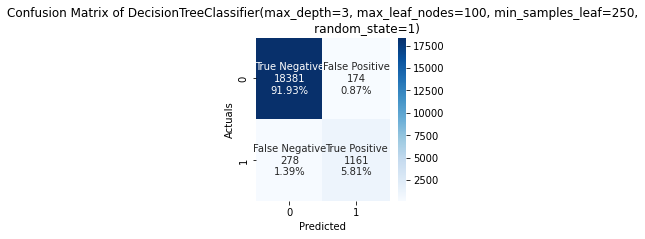

Model: BaggingClassifier(base_estimator=LogisticRegression(random_state=1),
                  max_features=20, max_samples=1000, n_estimators=100)

Train Accuracy:  96.64%
Train Precision:  87.91%
Train Recall:  61.77%
Train F1-score:  72.55%
Train Logloss: 0.09595
CV accuracy:  96.54%
CV logloss:  0.09554
Test Accuracy: 96.68%
Test Precision:  87.31%
Test Recall:  63.10%
Test F1-score:  73.26%
Test Logloss: 0.09479

               precision    recall  f1-score   support

         0.0       0.97      0.99      0.98     18555
         1.0       0.87      0.63      0.73      1439

    accuracy                           0.97     19994
   macro avg       0.92      0.81      0.86     19994
weighted avg       0.96      0.97      0.96     19994



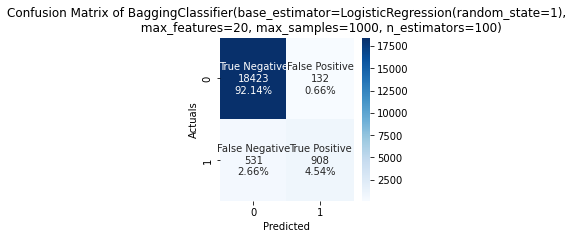

(RandomForestClassifier(max_depth=3, max_leaf_nodes=100, min_samples_leaf=250,
                       n_estimators=200, random_state=1), 'Random Forest Classifier')
Model: RandomForestClassifier(max_depth=3, max_leaf_nodes=100, min_samples_leaf=250,
                       n_estimators=200, random_state=1)

Train Accuracy:  95.81%
Train Precision:  100.00%
Train Recall:  41.69%
Train F1-score:  58.85%
Train Logloss: 0.10728
CV accuracy:  95.75%
CV logloss:  0.10830
Test Accuracy: 95.90%
Test Precision:  100.00%
Test Recall:  43.02%
Test F1-score:  60.16%
Test Logloss: 0.10591

               precision    recall  f1-score   support

         0.0       0.96      1.00      0.98     18555
         1.0       1.00      0.43      0.60      1439

    accuracy                           0.96     19994
   macro avg       0.98      0.72      0.79     19994
weighted avg       0.96      0.96      0.95     19994



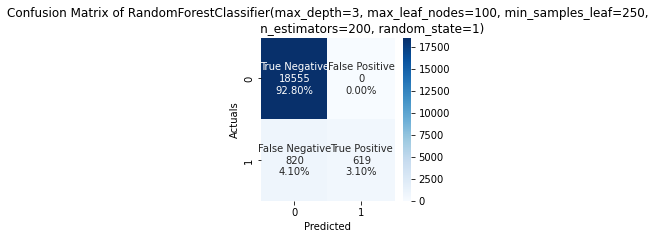

(AdaBoostClassifier(base_estimator=DecisionTreeClassifier(max_depth=1),
                   n_estimators=200, random_state=1), 'AdaBoost Classifier')
Model: AdaBoostClassifier(base_estimator=DecisionTreeClassifier(max_depth=1),
                   n_estimators=200, random_state=1)

Train Accuracy:  98.19%
Train Precision:  89.40%
Train Recall:  84.86%
Train F1-score:  87.07%
Train Logloss: 0.66401
CV accuracy:  98.18%
CV logloss:  0.66343
Test Accuracy: 98.14%
Test Precision:  88.70%
Test Recall:  85.06%
Test F1-score:  86.84%
Test Logloss: 0.66402

               precision    recall  f1-score   support

         0.0       0.99      0.99      0.99     18555
         1.0       0.89      0.85      0.87      1439

    accuracy                           0.98     19994
   macro avg       0.94      0.92      0.93     19994
weighted avg       0.98      0.98      0.98     19994



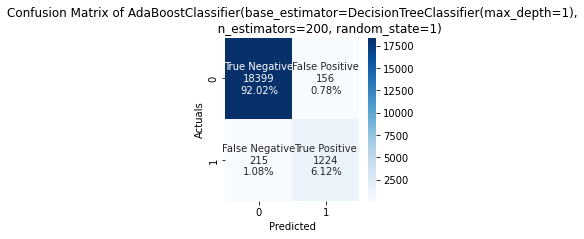

(XGBClassifier(early_stopping_round=5, n_estimators=500, random_state=1), 'XGBoost Classifier')
Model: XGBClassifier(early_stopping_round=5, n_estimators=500, random_state=1)

Train Accuracy:  98.56%
Train Precision:  95.75%
Train Recall:  83.72%
Train F1-score:  89.33%
Train Logloss: 0.03884
CV accuracy:  98.33%
CV logloss:  0.04476
Test Accuracy: 98.31%
Test Precision:  93.80%
Test Recall:  82.00%
Test F1-score:  87.50%
Test Logloss: 0.04497

               precision    recall  f1-score   support

         0.0       0.99      1.00      0.99     18555
         1.0       0.94      0.82      0.88      1439

    accuracy                           0.98     19994
   macro avg       0.96      0.91      0.93     19994
weighted avg       0.98      0.98      0.98     19994



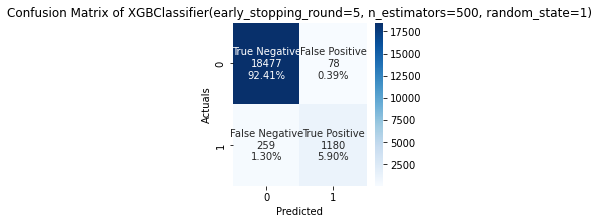

                         Train Accuracy Train Precision Train Recall  \
Model                                                                  
Dummy Classifier              92.806331             0.0          0.0   
Logistic Regression           97.023266       81.647589    75.616962   
Decision Tree Classifier      97.745884        87.15441     80.53528   
Bagging Classifier            96.638204       87.905021    61.765728   
Random Forest Classifier      95.805568           100.0    41.692735   
AdaBoost Classifier           98.187205       89.399487    84.862704   
XGBoost Classifier            98.561016       95.746372    83.715676   

                         Train F1 Score Train Logloss Validation Accuracy  \
Model                                                                       
Dummy Classifier                    0.0      2.484605           92.806331   
Logistic Regression           78.516647      0.069986           97.015763   
Decision Tree Classifier      83.714208    

In [118]:
from sklearn.metrics import classification_report

# Loop through all models to get scores and then output
models = [dum, log, dt, bag, rf, ada, xgb]
names = ["Dummy Classifier", "Logistic Regression", "Decision Tree Classifier", "Bagging Classifier", 
        "Random Forest Classifier", "AdaBoost Classifier", "XGBoost Classifier"]

output_tab = pd.DataFrame(columns=["Train Accuracy", "Train Precision", "Train Recall", "Train F1 Score", "Train Logloss", "Validation Accuracy", 
                                  "Validation_Logloss", "Test Accuracy", "Test Precision", "Test Recall", "Test F1 Score", "Test Logloss"])
output_pred = pd.DataFrame()

for (model, name) in zip(models, names):
  print((model,name))
  train_acc, train_pre, train_rec, train_f1, train_logloss, cv_acc, cv_logloss, test_acc, test_pre, test_rec, test_f1, test_logloss, train_y_pred, test_y_pred = test_val_outputs(model, x_train_F, y_train_F, x_test_F, y_test_F)
  print("\n",classification_report(y_test_F, test_y_pred, zero_division=0))

  # Load model outputs into a dataframe
  output_tab.at[name] = [train_acc, train_pre, train_rec, train_f1, train_logloss, cv_acc, cv_logloss, test_acc, test_pre, test_rec, test_f1, test_logloss]
  # Load predicted values for y_pred on test dataset into dataframe
  output_pred[name] = test_y_pred
  #visualise results in confusion matrix
  conf_mat_plot(y_test_F, test_y_pred, model)
  plt.show()
output_tab.index.name = "Model"
print(output_tab)
print(output_pred.shape)


### 4.6 Fit & Predict Artificial Neural Network for Keras model

In [119]:
# Set up metrics for ANN
from keras import backend as K

def recall_m(y_test_F, ann_pred): # TPR
    true_positives = K.sum(K.round(K.clip(y_test_F * ann_pred, 0, 1))) # TP
    possible_positives = K.sum(K.round(K.clip(y_test_F, 0, 1))) # P
    recall = true_positives / (possible_positives + K.epsilon())
    return recall

def precision_m(y_test_F, ann_pred):
    true_positives = K.sum(K.round(K.clip(y_test_F * ann_pred, 0, 1))) # TP
    predicted_positives = K.sum(K.round(K.clip(ann_pred, 0, 1))) # TP + FP
    precision = true_positives / (predicted_positives + K.epsilon())
    return precision

def f1_m(y_test_F, ann_pred):
    precision = precision_m(y_test_F, ann_pred)
    recall = recall_m(y_test_F, ann_pred)
    return 2*((precision*recall)/(precision+recall+K.epsilon()))

Epoch 1/80
313/313 [==============================] - 2s 4ms/step - loss: 0.0882 - Accuracy: 0.9642 - precision_m: 0.7474 - recall_m: 0.6706 - f1_m: 0.6964
Epoch 2/80
313/313 [==============================] - 1s 4ms/step - loss: 0.0648 - Accuracy: 0.9736 - precision_m: 0.8431 - recall_m: 0.7767 - f1_m: 0.8028
Epoch 3/80
313/313 [==============================] - 1s 3ms/step - loss: 0.0564 - Accuracy: 0.9777 - precision_m: 0.8814 - recall_m: 0.7982 - f1_m: 0.8331
Epoch 4/80
313/313 [==============================] - 1s 3ms/step - loss: 0.0515 - Accuracy: 0.9799 - precision_m: 0.9043 - recall_m: 0.8084 - f1_m: 0.8489
Epoch 5/80
313/313 [==============================] - 1s 3ms/step - loss: 0.0489 - Accuracy: 0.9813 - precision_m: 0.9169 - recall_m: 0.8125 - f1_m: 0.8575
Epoch 6/80
313/313 [==============================] - 1s 4ms/step - loss: 0.0474 - Accuracy: 0.9816 - precision_m: 0.9201 - recall_m: 0.8107 - f1_m: 0.8575
Epoch 7/80
313/313 [==============================] - 1s 3ms/ste

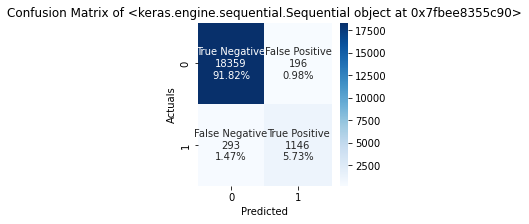

In [120]:
# Artificial Neural Network is fitted and predicted separately due to different initiation methodology and time taken to run
from keras.models import Sequential
from keras.layers import Dense
import keras.metrics as metrics
from keras.initializers import Constant

# Compile uses two layers, binary_crossentropy as proxy for log-loss. Returns accuracy, precision, recall and f1 measures.
ann = Sequential()
ann.add(Dense(512, input_dim=33, activation="relu"))
ann.add(Dense(256, activation="relu"))
ann.add(Dense(1, activation="sigmoid"))
ann.compile(loss="binary_crossentropy", optimizer="adam", metrics=[metrics.BinaryAccuracy(name="Accuracy"), precision_m, recall_m, f1_m])
pd.DataFrame(ann.fit(x_train_F, y_train_F, epochs=80, batch_size=256).history).to_csv("history.csv") # Outputs all epoch metrics to CSV
ann_pred = ann.predict(x_test_F)

conf_mat_plot(y_test_F, ann_pred, ann)
plt.show()


In [121]:
from sklearn.metrics import classification_report
# Evaluation metrics must be generated slightly differently for ANN, so I have adjusted the function below.
model = ann
xtrain = x_train_F
ytrain = y_train_F
xtest = x_test_F
ytest = y_test_F
name = "Artificial Neural Network"

output_tab1 = pd.DataFrame(columns=["Train Accuracy", "Train Precision", "Train Recall", "Train F1 Score", "Train Logloss", "Validation Accuracy", 
                                  "Validation_Logloss", "Test Accuracy", "Test Precision", "Test Recall", "Test F1 Score", "Test Logloss"])
output_pred1 = pd.DataFrame()

train_y_pred = model.predict(xtrain)
test_y_pred = ann_pred
#train_y_pred = (train_y_pred > 0.5).astype(np.float32)
train_acc = met.accuracy_score(np.ravel(ytrain), np.ravel((train_y_pred > 0.5).astype(np.float32))) * 100
train_pre = met.precision_score(np.ravel(ytrain),np.ravel((train_y_pred > 0.5).astype(np.float32))) * 100
train_rec = met.recall_score(np.ravel(ytrain),np.ravel((train_y_pred > 0.5).astype(np.float32))) * 100
train_f1 = met.f1_score(np.ravel(ytrain),np.ravel((train_y_pred > 0.5).astype(np.float32))) * 100
train_logloss = "N/A"
cv_acc = "N/A"
cv_logloss = "N/A"
test_acc = met.accuracy_score(ytest, (test_y_pred > 0.5).astype(np.float32)) * 100
test_pre = met.precision_score(np.ravel(ytest),np.ravel((test_y_pred > 0.5).astype(np.float32))) * 100
test_rec = met.recall_score(np.ravel(ytest),np.ravel((test_y_pred > 0.5).astype(np.float32))) * 100
test_f1 = met.f1_score(np.ravel(ytest),np.ravel((test_y_pred > 0.5).astype(np.float32))) * 100
test_logloss = "N/A"

print(ann.evaluate)
print(ann.metrics_names)

print((model,name))
train_acc, train_pre, train_rec, train_f1, train_logloss, cv_acc, cv_logloss, test_acc, test_pre, test_rec, test_f1, test_logloss, train_y_pred, test_y_pred

# Load model outputs into a dataframe
output_tab1.at[name] = [train_acc, train_pre, train_rec, train_f1, train_logloss, cv_acc, cv_logloss, test_acc, test_pre, test_rec, test_f1, test_logloss]
# Load predicted values for y_pred on test dataset into dataframe
output_pred1[name] = np.ravel((test_y_pred > 0.5).astype(np.float32))
plt.show()

output_tab1.index.name = "Model"
print(output_tab1)

<bound method Model.evaluate of <keras.engine.sequential.Sequential object at 0x7fbee8355c90>>
['loss', 'Accuracy', 'precision_m', 'recall_m', 'f1_m']
(<keras.engine.sequential.Sequential object at 0x7fbee8355c90>, 'Artificial Neural Network')
                          Train Accuracy Train Precision Train Recall  \
Model                                                                   
Artificial Neural Network      99.442409       98.324836    93.847758   

                          Train F1 Score Train Logloss Validation Accuracy  \
Model                                                                        
Artificial Neural Network      96.034145           N/A                 N/A   

                          Validation_Logloss Test Accuracy Test Precision  \
Model                                                                       
Artificial Neural Network                N/A     97.554266      85.394933   

                          Test Recall Test F1 Score Test Logloss  
Mo

# 5: Model Validation and Evaluation





## 5.1: Accuracy Metrics and Loss Function

The classification report allows us to understand how well the model performs on each target class, displaying effectiveness metrics for each classifier vs. test dataset.

The confusion matrix is a good visual for interpretation.
* TP = True Positive
* TN = True Negative
* FP = False Positive
* FN = False Negative

In our imbalanced dataset, Accuracy is a misleading statistic as high values could just demonstrate strong negative class predictive capability. Approving a fraudulent transaction (FN) would have a large financial cost, so it's important to maximise Recall, while high Precision will help to offset any detrimental customer impact as a result of incorrectly predicting a fraudulent transaction. F1 score analyses both within one outcome. Together these are our core evaluation metrics. (Koo Ping Shung, 2018).

$Accuracy = \frac{TP+TN}{TP+FP+FN+TN}$ - What percentage of records were labelled correctly?

$Precision = \frac{TP}{TP+FP}$ - For all transactions that we have labelled as Fraud, what proportion were actually Fraud?

$Recall = \frac{TP}{TP+FN}$ - For all transactions actually marked as Fraud, what proportion did we label correctly?

$F1 Score = \frac {TP}{TP+\frac{1}{2}(FP+FN)}$ - Weighted average of Precision & Recall

The Logloss metric is also an effective measure for binary classification with an imbalanced dataset, since it does not overemphasise successful prediction for a particular class. 

Logloss considers the probabilities underlying model scores, and not only the final output of the classification, so is a measure of uncertainty in this respect. If probabilities are closer to 1 or 0, the Logloss will be closer to zero (Zammito, 2019).

The Logloss formula for binary classification is (Pedregosa et al., 2011): 
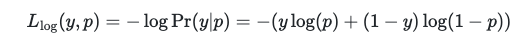


Confusion Matrix for Dummy:


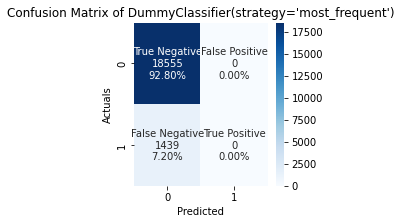

Confusion Matrix for Logistic Regression:


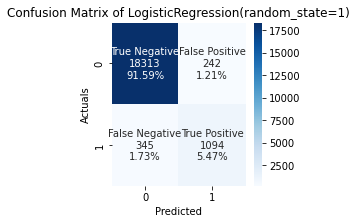

Confusion Matrix for Decision Tree:


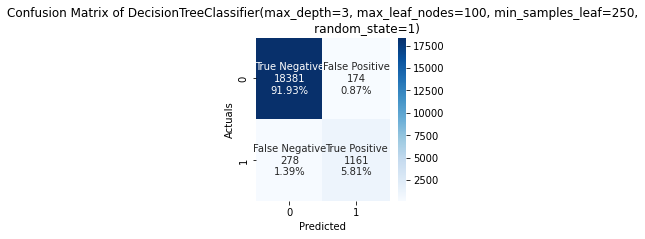

Confusion Matrix for Bagging Classifier:


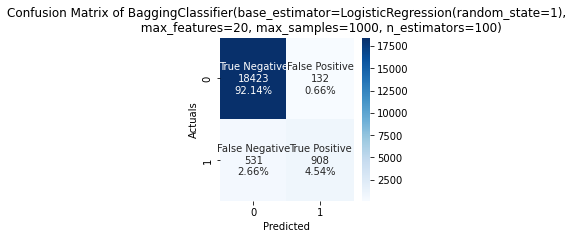

Confusion Matrix for Random Forest Classifier:


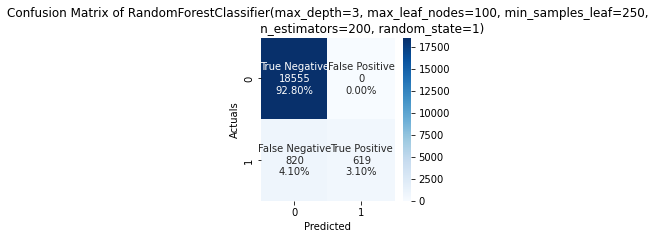

Confusion Matrix for AdaBoost Classifier:


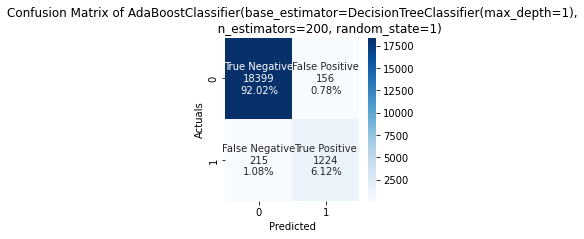

Confusion Matrix for XGBoost Classifier:


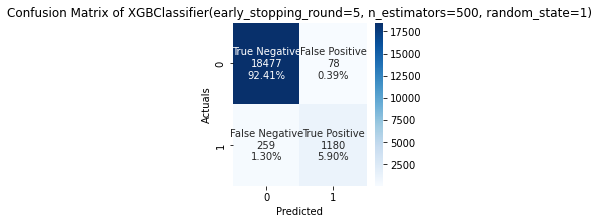

Confusion Matrix for Artificial Neural Network Classifier:


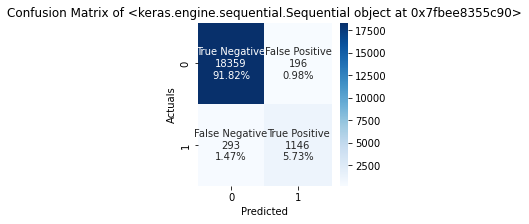

In [122]:
# Confusion matrices side by side.
print("Confusion Matrix for Dummy:")
conf_mat_plot(y_test_F, output_pred['Dummy Classifier'], dum)
plt.show()
print("Confusion Matrix for Logistic Regression:")
conf_mat_plot(y_test_F, output_pred['Logistic Regression'], log)
plt.show()
print("Confusion Matrix for Decision Tree:")
conf_mat_plot(y_test_F, output_pred['Decision Tree Classifier'], dt)
plt.show()
print("Confusion Matrix for Bagging Classifier:")
conf_mat_plot(y_test_F, output_pred['Bagging Classifier'], bag)
plt.show()
print("Confusion Matrix for Random Forest Classifier:")
conf_mat_plot(y_test_F, output_pred['Random Forest Classifier'], rf)
plt.show()
print("Confusion Matrix for AdaBoost Classifier:")
conf_mat_plot(y_test_F, output_pred['AdaBoost Classifier'], ada)
plt.show()
print("Confusion Matrix for XGBoost Classifier:")
conf_mat_plot(y_test_F, output_pred['XGBoost Classifier'], xgb)
plt.show()
print("Confusion Matrix for Artificial Neural Network Classifier:")
conf_mat_plot(y_test_F, ann_pred, ann)
plt.show()

In [123]:
# Merge two output tables from classifications
output_tab_F = output_tab.append(output_tab1)
output_tab_F

,Train Accuracy,Train Precision,Train Recall,Train F1 Score,Train Logloss,Validation Accuracy,Validation_Logloss,Test Accuracy,Test Precision,Test Recall,Test F1 Score,Test Logloss
Model,,,,,,,,,,,,
Dummy Classifier,92.806331,0.0,0.0,0.0,2.484605,92.806331,2.484605,92.802841,0.0,0.0,0.0,2.485811
Logistic Regression,97.023266,81.647589,75.616962,78.516647,0.069986,97.015763,0.070284,97.064119,81.886228,76.025017,78.846847,0.068413
Decision Tree Classifier,97.745884,87.15441,80.53528,83.714208,0.063987,97.735881,0.064141,97.739322,86.966292,80.681028,83.70584,0.06252
Bagging Classifier,96.638204,87.905021,61.765728,72.552822,0.095946,96.538187,0.095544,96.684005,87.307692,63.099375,73.255345,0.094786
Random Forest Classifier,95.805568,100.0,41.692735,58.849503,0.10728,95.75056,0.108296,95.89877,100.0,43.015983,60.155491,0.105914
AdaBoost Classifier,98.187205,89.399487,84.862704,87.07204,0.66401,98.179703,0.663433,98.144443,88.695652,85.059069,86.839305,0.664015
XGBoost Classifier,98.561016,95.746372,83.715676,89.32777,0.038844,98.325978,0.044761,98.314494,93.799682,82.00139,87.504635,0.044974
Artificial Neural Network,99.442409,98.324836,93.847758,96.034145,N/A,N/A,N/A,97.554266,85.394933,79.638638,82.416397,N/A


## 5.2: Initial Model Evaluation - no class balancing

An evaluation of each model against the test dataset shows the following, excluding Dummy Classifier:
* **Logistic Regression**: Low F1 and Recall, model generalises well. Precision score worst of all models. 
* **Decision Tree**: Accuracy of 97.7%, generalises well across all datasets. F1 score is 84.4%. Increasing max-depth could improve performance, but may cause overfitting.
* **Bagging Classifier**: Generalises well, but couldn’t improve upon logistic regresion F1.
* **Random Forest**: 100% precision, but Recall was 43%, meaning many fraudulent transactions would get accepted. 
* **AdaBoost**: Best F1 score, Recall and good Precision, it predicts the lowest volume of false negative values. Logloss is the worst. 
* **XGBoost**: Best outcome on Logloss, Accuracy and Precision, though doesn't generalise as well as others. 
* **Neural Network**: F1score of 82.8% puts this in middle of the pack. 

## 5.3: Model Tuning - parameter amends and catering for class imbalance

In [124]:
# Instantiate each amended model type with new name. Here I could refer to importance of class_weight, and gridsearch
# for tuning hyperparameters in a production environment, given more time.

# Logistic Regression - Class weight balanced
log2 = LogisticRegression(class_weight='balanced', random_state=1)
# Decision Tree - Class weight balanced and max depth increased to 5.
dt2 = DecisionTreeClassifier(splitter='best', class_weight='balanced', max_depth=5, max_leaf_nodes=150, min_samples_leaf = 250, random_state=1)
# Bagging Classifier - Class weight balanced, aiming to improve on logistic regression, creating 100 different classifiers on 100 different no max features.
bag2 = BaggingClassifier(LogisticRegression(class_weight='balanced'),
                        n_estimators=100, max_samples=100, bootstrap=True, random_state=1)
# Random Forest - Increase max depth and max leaf nodes, decrease estimators to 100. Class weight balanced.
rf2 = RandomForestClassifier(class_weight='balanced', max_depth=5, max_leaf_nodes=150, min_samples_leaf = 250, n_estimators=100, random_state=1)
# Ada Boost Classifier - We will train a Decision Tree from the base using 200 estimators, amend learning rate. Class weight balanced
ada2 = AdaBoostClassifier(DecisionTreeClassifier(max_depth=1, class_weight='balanced'), n_estimators=200, algorithm="SAMME.R", learning_rate=0.1, random_state=1)
# XGBoost Classifier model with 500 classifiers and early stopping. Class weight balanced.
xgb2 = XGBClassifier(n_estimators=500, scale_pos_weight = (92.8/7.2), early_stopping_round=5, random_state=1)

(LogisticRegression(class_weight='balanced', random_state=1), 'Logistic Regression 2')
Model: LogisticRegression(class_weight='balanced', random_state=1)

Train Accuracy:  92.79%
Train Precision:  49.96%
Train Recall:  96.65%
Train F1-score:  65.87%
Train Logloss: 0.15276
CV accuracy:  92.77%
CV logloss:  0.15316
Test Accuracy: 92.64%
Test Precision:  49.43%
Test Recall:  97.01%
Test F1-score:  65.49%
Test Logloss: 0.15425

               precision    recall  f1-score   support

         0.0       1.00      0.92      0.96     18555
         1.0       0.49      0.97      0.65      1439

    accuracy                           0.93     19994
   macro avg       0.75      0.95      0.81     19994
weighted avg       0.96      0.93      0.94     19994



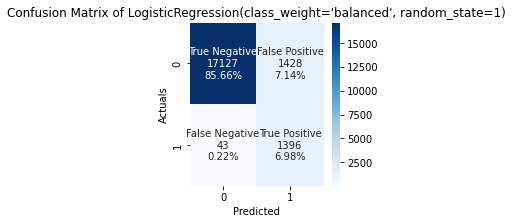

(DecisionTreeClassifier(class_weight='balanced', max_depth=5, max_leaf_nodes=150,
                       min_samples_leaf=250, random_state=1), 'Decision Tree Classifier 2')
Model: DecisionTreeClassifier(class_weight='balanced', max_depth=5, max_leaf_nodes=150,
                       min_samples_leaf=250, random_state=1)

Train Accuracy:  93.61%
Train Precision:  53.09%
Train Recall:  95.97%
Train F1-score:  68.36%
Train Logloss: 0.12911
CV accuracy:  93.64%
CV logloss:  0.13153
Test Accuracy: 93.46%
Test Precision:  52.50%
Test Recall:  96.32%
Test F1-score:  67.96%
Test Logloss: 0.13321

               precision    recall  f1-score   support

         0.0       1.00      0.93      0.96     18555
         1.0       0.53      0.96      0.68      1439

    accuracy                           0.93     19994
   macro avg       0.76      0.95      0.82     19994
weighted avg       0.96      0.93      0.94     19994



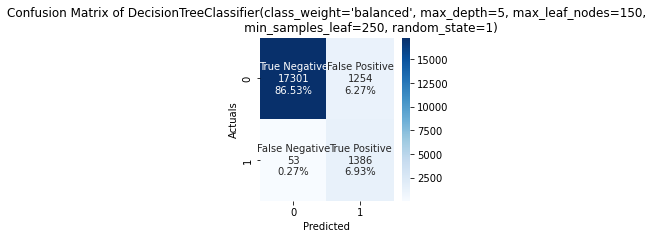

(BaggingClassifier(base_estimator=LogisticRegression(class_weight='balanced'),
                  max_samples=100, n_estimators=100, random_state=1), 'Bagging Classifier 2')
Model: BaggingClassifier(base_estimator=LogisticRegression(class_weight='balanced'),
                  max_samples=100, n_estimators=100, random_state=1)

Train Accuracy:  94.44%
Train Precision:  57.88%
Train Recall:  83.58%
Train F1-score:  68.39%
Train Logloss: 0.14436
CV accuracy:  94.35%
CV logloss:  0.14674
Test Accuracy: 94.60%
Test Precision:  58.59%
Test Recall:  85.34%
Test F1-score:  69.48%
Test Logloss: 0.14431

               precision    recall  f1-score   support

         0.0       0.99      0.95      0.97     18555
         1.0       0.59      0.85      0.69      1439

    accuracy                           0.95     19994
   macro avg       0.79      0.90      0.83     19994
weighted avg       0.96      0.95      0.95     19994



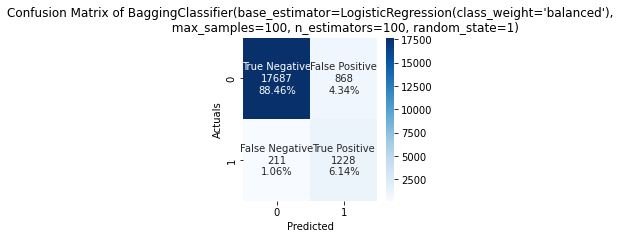

(RandomForestClassifier(class_weight='balanced', max_depth=5, max_leaf_nodes=150,
                       min_samples_leaf=250, random_state=1), 'Random Forest Classifier 2')
Model: RandomForestClassifier(class_weight='balanced', max_depth=5, max_leaf_nodes=150,
                       min_samples_leaf=250, random_state=1)

Train Accuracy:  93.11%
Train Precision:  51.11%
Train Recall:  96.92%
Train F1-score:  66.93%
Train Logloss: 0.19569
CV accuracy:  93.18%
CV logloss:  0.20026
Test Accuracy: 92.92%
Test Precision:  50.41%
Test Recall:  97.43%
Test F1-score:  66.45%
Test Logloss: 0.19683

               precision    recall  f1-score   support

         0.0       1.00      0.93      0.96     18555
         1.0       0.50      0.97      0.66      1439

    accuracy                           0.93     19994
   macro avg       0.75      0.95      0.81     19994
weighted avg       0.96      0.93      0.94     19994



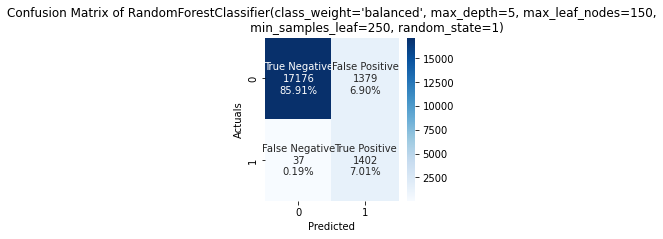

(AdaBoostClassifier(base_estimator=DecisionTreeClassifier(class_weight='balanced',
                                                         max_depth=1),
                   learning_rate=0.1, n_estimators=200, random_state=1), 'AdaBoost Classifier 2')
Model: AdaBoostClassifier(base_estimator=DecisionTreeClassifier(class_weight='balanced',
                                                         max_depth=1),
                   learning_rate=0.1, n_estimators=200, random_state=1)

Train Accuracy:  93.32%
Train Precision:  51.88%
Train Recall:  97.62%
Train F1-score:  67.76%
Train Logloss: 0.55063
CV accuracy:  93.65%
CV logloss:  0.54640
Test Accuracy: 93.14%
Test Precision:  51.24%
Test Recall:  97.98%
Test F1-score:  67.29%
Test Logloss: 0.55095

               precision    recall  f1-score   support

         0.0       1.00      0.93      0.96     18555
         1.0       0.51      0.98      0.67      1439

    accuracy                           0.93     19994
   macro avg       0.76

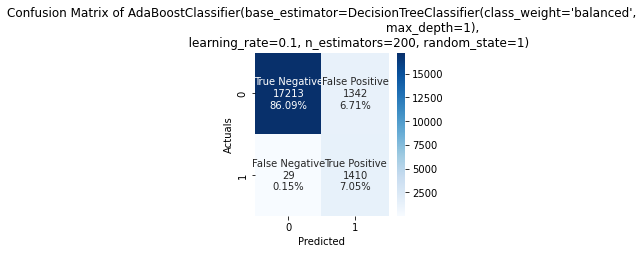

(XGBClassifier(early_stopping_round=5, n_estimators=500, random_state=1,
              scale_pos_weight=12.888888888888888), 'XGBoost Classifier 2')


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:2442: RuntimeWarning: divide by zero encountered in log
  loss = -(transformed_labels * np.log(y_pred)).sum(axis=1)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:2442: RuntimeWarning: invalid value encountered in multiply
  loss = -(transformed_labels * np.log(y_pred)).sum(axis=1)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:2442: RuntimeWarning: divide by zero encountered in log
  loss = -(transformed_labels * np.log(y_pred)).sum(axis=1)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:2442: RuntimeWarning: invalid value encountered in multiply
  loss = -(transformed_labels * np.log(y_pred)).sum(axis=1)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:2442: RuntimeWarning: divide by zero encountered in log
  loss = -(transformed_labels * np.log(y_pred)).sum(axis=1)
/usr/local/lib/python3.7/dist-packages/skl

Model: XGBClassifier(early_stopping_round=5, n_estimators=500, random_state=1,
              scale_pos_weight=12.888888888888888)

Train Accuracy:  95.13%
Train Precision:  59.89%
Train Recall:  97.86%
Train F1-score:  74.31%
Train Logloss: 0.09023
CV accuracy:  94.96%
CV logloss:  nan
Test Accuracy: 94.61%
Test Precision:  57.53%
Test Recall:  95.83%
Test F1-score:  71.90%
Test Logloss: 0.09979

               precision    recall  f1-score   support

         0.0       1.00      0.95      0.97     18555
         1.0       0.58      0.96      0.72      1439

    accuracy                           0.95     19994
   macro avg       0.79      0.95      0.84     19994
weighted avg       0.97      0.95      0.95     19994



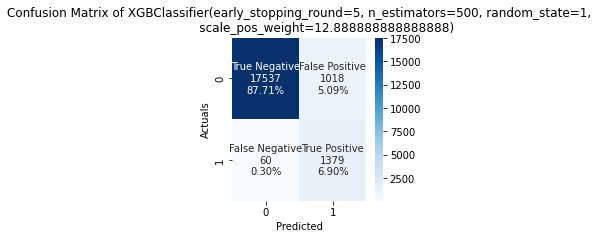

(19994, 6)


In [125]:
from sklearn.metrics import classification_report
# Loop through all models to get scores and then output
models = [log2, dt2, bag2, rf2, ada2, xgb2]
names = ["Logistic Regression 2", "Decision Tree Classifier 2", "Bagging Classifier 2", 
        "Random Forest Classifier 2", "AdaBoost Classifier 2", "XGBoost Classifier 2"]

output_tab2 = pd.DataFrame(columns=["Train Accuracy", "Train Precision", "Train Recall", "Train F1 Score", "Train Logloss", "Validation Accuracy", 
                                  "Validation_Logloss", "Test Accuracy", "Test Precision", "Test Recall", "Test F1 Score", "Test Logloss"])
output_pred2 = pd.DataFrame()

for (model, name) in zip(models, names):
  print((model,name))
  train_acc, train_pre, train_rec, train_f1, train_logloss, cv_acc, cv_logloss, test_acc, test_pre, test_rec, test_f1, test_logloss, train_y_pred, test_y_pred = test_val_outputs(model, x_train_F, y_train_F, x_test_F, y_test_F)
  print("\n",classification_report(y_test_F, test_y_pred, zero_division=0))

  # Load model outputs into a dataframe
  output_tab2.at[name] = [train_acc, train_pre, train_rec, train_f1, train_logloss, cv_acc, cv_logloss, test_acc, test_pre, test_rec, test_f1, test_logloss]
  # Load predicted values for y_pred on test dataset into dataframe
  output_pred2[name] = test_y_pred
  #visualise results in confusion matrix
  conf_mat_plot(y_test_F, test_y_pred, model)
  plt.show()
output_tab.index.name = "Model"
print(output_pred2.shape)

5.3.1: Balancing Artificial Neural Network classes can use bias_initializer (Tensorflow, n.d.)

In [126]:
# Set up metrics for ANN2
from keras import backend as K

def recall_m(y_test_F, ann2_pred): # TPR
    true_positives = K.sum(K.round(K.clip(y_test_F * ann2_pred, 0, 1))) # TP
    possible_positives = K.sum(K.round(K.clip(y_test_F, 0, 1))) # P
    recall = true_positives / (possible_positives + K.epsilon())
    return recall

def precision_m(y_test_F, ann2_pred):
    true_positives = K.sum(K.round(K.clip(y_test_F * ann2_pred, 0, 1))) # TP
    predicted_positives = K.sum(K.round(K.clip(ann2_pred, 0, 1))) # TP + FP
    precision = true_positives / (predicted_positives + K.epsilon())
    return precision

def f1_m(y_test_F, ann2_pred):
    precision = precision_m(y_test_F, ann2_pred)
    recall = recall_m(y_test_F, ann2_pred)
    return 2*((precision*recall)/(precision+recall+K.epsilon()))



[-2.55636561]
Epoch 1/80
313/313 [==============================] - 2s 4ms/step - loss: 0.0779 - Accuracy: 0.9675 - precision_m: 0.7931 - recall_m: 0.7158 - f1_m: 0.7429
Epoch 2/80
313/313 [==============================] - 1s 4ms/step - loss: 0.0631 - Accuracy: 0.9745 - precision_m: 0.8562 - recall_m: 0.7798 - f1_m: 0.8106
Epoch 3/80
313/313 [==============================] - 1s 4ms/step - loss: 0.0550 - Accuracy: 0.9786 - precision_m: 0.8899 - recall_m: 0.8034 - f1_m: 0.8393
Epoch 4/80
313/313 [==============================] - 1s 4ms/step - loss: 0.0510 - Accuracy: 0.9802 - precision_m: 0.9066 - recall_m: 0.8072 - f1_m: 0.8493
Epoch 5/80
313/313 [==============================] - 1s 4ms/step - loss: 0.0487 - Accuracy: 0.9816 - precision_m: 0.9222 - recall_m: 0.8125 - f1_m: 0.8596
Epoch 6/80
313/313 [==============================] - 1s 4ms/step - loss: 0.0471 - Accuracy: 0.9818 - precision_m: 0.9264 - recall_m: 0.8167 - f1_m: 0.8634
Epoch 7/80
313/313 [==============================

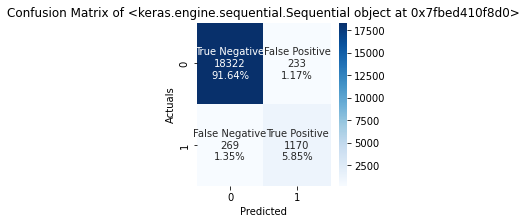

In [128]:
# Artificial Neural Network is fitted and predicted separately due to different initiation methodology and time taken to run
from keras.models import Sequential
from keras.layers import Dense
import keras.metrics as metrics
from keras.initializers import Constant

output_bias = np.log([7.2/92.8])
print(output_bias)

# Compile uses two layers, binary_crossentropy as proxy for log-loss and returns accuracy, precision, recall and f1 measures.
# This model will balance clases with bias_initializer.
output_bias = Constant(output_bias)
ann2 = Sequential()
ann2.add(Dense(512, input_dim=33, activation="relu"))
ann2.add(Dense(256, activation="relu"))
ann2.add(Dense(1, activation="sigmoid", bias_initializer=output_bias))
ann2.compile(loss="binary_crossentropy", optimizer="adam", metrics=[metrics.BinaryAccuracy(name="Accuracy"), precision_m, recall_m, f1_m])
pd.DataFrame(ann2.fit(x_train_F, y_train_F, epochs=80, batch_size=256).history).to_csv("history2.csv")
ann2_pred = ann2.predict(x_test_F)

conf_mat_plot(y_test_F, ann2_pred, ann2)
plt.show()


In [129]:
from sklearn.metrics import classification_report
# Evaluation metrics must be generated slightly differently for ANN, so I have adjusted the function below.
model = ann2
xtrain = x_train_F
ytrain = y_train_F
xtest = x_test_F
ytest = y_test_F
name = "Artificial Neural Network 2"

output_tab3 = pd.DataFrame(columns=["Train Accuracy", "Train Precision", "Train Recall", "Train F1 Score", "Train Logloss", "Validation Accuracy", 
                                  "Validation_Logloss", "Test Accuracy", "Test Precision", "Test Recall", "Test F1 Score", "Test Logloss"])
output_pred3 = pd.DataFrame()

train_y_pred = model.predict(xtrain)
test_y_pred = ann2_pred

train_acc = met.accuracy_score(np.ravel(ytrain), np.ravel((train_y_pred > 0.5).astype(np.float32))) * 100
train_pre = met.precision_score(np.ravel(ytrain),np.ravel((train_y_pred > 0.5).astype(np.float32))) * 100
train_rec = met.recall_score(np.ravel(ytrain),np.ravel((train_y_pred > 0.5).astype(np.float32))) * 100
train_f1 = met.f1_score(np.ravel(ytrain),np.ravel((train_y_pred > 0.5).astype(np.float32))) * 100
train_logloss = "N/A"
cv_acc = "N/A"
cv_logloss = "N/A"
test_acc = met.accuracy_score(ytest, (test_y_pred > 0.5).astype(np.float32)) * 100
test_pre = met.precision_score(np.ravel(ytest),np.ravel((test_y_pred > 0.5).astype(np.float32))) * 100
test_rec = met.recall_score(np.ravel(ytest),np.ravel((test_y_pred > 0.5).astype(np.float32))) * 100
test_f1 = met.f1_score(np.ravel(ytest),np.ravel((test_y_pred > 0.5).astype(np.float32))) * 100
test_logloss = "N/A"

print(ann2.evaluate)
print(ann2.metrics_names)

print((model,name))
train_acc, train_pre, train_rec, train_f1, train_logloss, cv_acc, cv_logloss, test_acc, test_pre, test_rec, test_f1, test_logloss, train_y_pred, test_y_pred

# Load model outputs into a dataframe
output_tab3.at[name] = [train_acc, train_pre, train_rec, train_f1, train_logloss, cv_acc, cv_logloss, test_acc, test_pre, test_rec, test_f1, test_logloss]
# Load predicted values for y_pred on test dataset into dataframe
output_pred3[name] = np.ravel((test_y_pred > 0.5).astype(np.float32))
plt.show()

output_tab1.index.name = "Model"
print(output_tab3)

<bound method Model.evaluate of <keras.engine.sequential.Sequential object at 0x7fbed410f8d0>>
['loss', 'Accuracy', 'precision_m', 'recall_m', 'f1_m']
(<keras.engine.sequential.Sequential object at 0x7fbed410f8d0>, 'Artificial Neural Network 2')
                            Train Accuracy Train Precision Train Recall  \
Artificial Neural Network 2      99.414905       97.484729    94.299618   

                            Train F1 Score Train Logloss Validation Accuracy  \
Artificial Neural Network 2      95.865724           N/A                 N/A   

                            Validation_Logloss Test Accuracy Test Precision  \
Artificial Neural Network 2                N/A     97.489247       83.39273   

                            Test Recall Test F1 Score Test Logloss  
Artificial Neural Network 2   81.306463     82.336383          N/A  


In [148]:
# Merge tables containing outputs
output_tab_F = output_tab_F.append(output_tab2)
output_tab_F = output_tab_F.append(output_tab3)

output_pred_F = pd.concat([output_pred, output_pred1, output_pred2, output_pred3], 
                          axis = 1, sort = False)


## 5.4: Model Evaluation - classes balanced

After balancing the class weights, most models have improved Recall scores, to the detriment of Precision, which means more cases would be flagged as Fraud when they aren't. F1 scores are all lower as a result. While these models can be recommended for reducing fraud loss, they would come at a customer experience cost, whereby held or blocked transactions would cause payment disruption. 

further model tuning will support a more even prediction success rate across both classes.

If I were to recommend a model here it would be XGBoost based on the highest F1 score alongside other metrics. If we are looking to minimise false negatives as a priority, the weight-balanced AdaBoost does the best job, generalising well, though Precision is poor.

## 5.5: Table of model outputs


In [134]:
# The table below shows the evaulation metrics for all models built for comparison purposes.
output_tab_F

,Train Accuracy,Train Precision,Train Recall,Train F1 Score,Train Logloss,Validation Accuracy,Validation_Logloss,Test Accuracy,Test Precision,Test Recall,Test F1 Score,Test Logloss
Dummy Classifier,92.806331,0.0,0.0,0.0,2.484605,92.806331,2.484605,92.802841,0.0,0.0,0.0,2.485811
Logistic Regression,97.023266,81.647589,75.616962,78.516647,0.069986,97.015763,0.070284,97.064119,81.886228,76.025017,78.846847,0.068413
Decision Tree Classifier,97.745884,87.15441,80.53528,83.714208,0.063987,97.735881,0.064141,97.739322,86.966292,80.681028,83.70584,0.06252
Bagging Classifier,96.638204,87.905021,61.765728,72.552822,0.095946,96.538187,0.095544,96.684005,87.307692,63.099375,73.255345,0.094786
Random Forest Classifier,95.805568,100.0,41.692735,58.849503,0.10728,95.75056,0.108296,95.89877,100.0,43.015983,60.155491,0.105914
AdaBoost Classifier,98.187205,89.399487,84.862704,87.07204,0.66401,98.179703,0.663433,98.144443,88.695652,85.059069,86.839305,0.664015
XGBoost Classifier,98.561016,95.746372,83.715676,89.32777,0.038844,98.325978,0.044761,98.314494,93.799682,82.00139,87.504635,0.044974
Artificial Neural Network,99.442409,98.324836,93.847758,96.034145,N/A,N/A,N/A,97.554266,85.394933,79.638638,82.416397,N/A
Logistic Regression 2,92.793829,49.955084,96.645812,65.865214,0.152762,92.766322,0.153157,92.642793,49.433428,97.011814,65.493784,0.154246
Decision Tree Classifier 2,93.608961,53.085945,95.968022,68.358505,0.129112,93.635212,0.131525,93.463039,52.5,96.316887,67.957833,0.133207


In [149]:
# The output_pred table shows the predicted outcome on the test dataset for all models built.
output_pred_F

,Dummy Classifier,Logistic Regression,Decision Tree Classifier,Bagging Classifier,Random Forest Classifier,AdaBoost Classifier,XGBoost Classifier,Artificial Neural Network,Logistic Regression 2,Decision Tree Classifier 2,Bagging Classifier 2,Random Forest Classifier 2,AdaBoost Classifier 2,XGBoost Classifier 2,Artificial Neural Network 2
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19989,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
19990,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
19991,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
19992,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0


In [150]:
# Save down final model output tables
output_tab_F.to_csv('ModelOutputStats.csv', mode='w', index=True)
output_pred_F.to_csv('ModelPredScores.csv', mode='w', index=True)

# Download dataset. This can then be used to continue script from step 6.
from google.colab import files
files.download('ModelOutputStats.csv')
files.download('ModelPredScores.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# <font color='orange'> 6: Model Illustrations</font>
Correlation Matrix/scores
Heat map
Confusions Matrix
Comparisons
Which would I recommend?

In [3]:
# Only need to run this section if you are starting from stage 6.
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn import tree 
import seaborn as sns 
%matplotlib inline

In [151]:
# These steps are necessary if you are starting from section 6.
output_tab_F = pd.read_csv('ModelOutputStats.csv')
output_tab_F.set_index(output_tab_F.columns[0], drop=True, inplace=True)
output_tab_F.index.name = "Index"

output_pred_F = pd.read_csv('ModelPredScores.csv')
output_pred_F.set_index(output_pred_F.columns[0], drop=True, inplace=True)
output_pred_F.index.name = "Index"

In [152]:
# Start from here without re-defining variables if you are running the script all in one go.
print("Model Outputs: \n")
print(output_tab_F.info(), "\n")
print("Test predictions: \n")
print(output_pred_F.info(), "\n")

Model Outputs: 

<class 'pandas.core.frame.DataFrame'>
Index: 15 entries, Dummy Classifier to Artificial Neural Network 2
Data columns (total 12 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   Train Accuracy       15 non-null     float64
 1   Train Precision      15 non-null     float64
 2   Train Recall         15 non-null     float64
 3   Train F1 Score       15 non-null     float64
 4   Train Logloss        13 non-null     float64
 5   Validation Accuracy  13 non-null     float64
 6   Validation_Logloss   12 non-null     float64
 7   Test Accuracy        15 non-null     float64
 8   Test Precision       15 non-null     float64
 9   Test Recall          15 non-null     float64
 10  Test F1 Score        15 non-null     float64
 11  Test Logloss         13 non-null     float64
dtypes: float64(12)
memory usage: 1.5+ KB
None 

Test predictions: 

<class 'pandas.core.frame.DataFrame'>
Int64Index: 19994 entries, 0 to 19993


## 6.1: Model visualisations

In addition to the metrics we have already created, we will look more closely at the favoured XGBoost (classes imbalanced) model

Confusion Matrix for XGBoost Classifier - classes imbalanced:


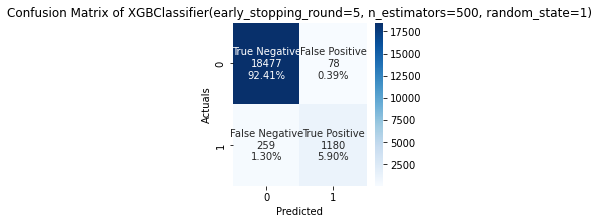

Confusion Matrix for XGBoost Classifier - classes balanced:


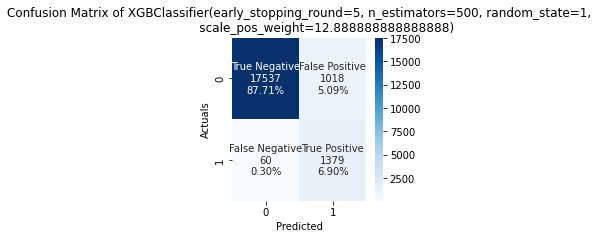

In [195]:
# Confusion Matrix for average outputs for both XGB models
print("Confusion Matrix for XGBoost Classifier - classes imbalanced:")
conf_mat_plot(y_test_F, output_pred_F['XGBoost Classifier'], xgb)
plt.show()

print("Confusion Matrix for XGBoost Classifier - classes balanced:")
conf_mat_plot(y_test_F, output_pred_F['XGBoost Classifier 2'], xgb2)
plt.show()

6.1.1: The confusion matrix clearly shows better prediction where classes are balanced, but there are too many false positives. The imbalanced classification allows 199 more fraudlent cases.

In [217]:
# Install Shap for further visuals
! pip install shap

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


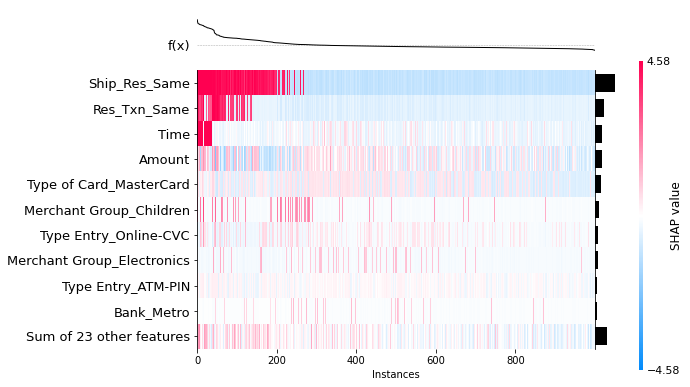

In [221]:
import shap

# SHAP values are able to show the impact of each feature vs. a baseline
explainer = shap.Explainer(xgb, x_test_F)
shap_values = explainer(x_test_F[:1000])

shap.plots.heatmap(shap_values, max_display=11, instance_order=shap_values.sum(1))

6.2.2: This view shows that where Shipping/Transaction location and Residence don't match, there is a higher likelihood of Fraud, closely followed by certain Times.

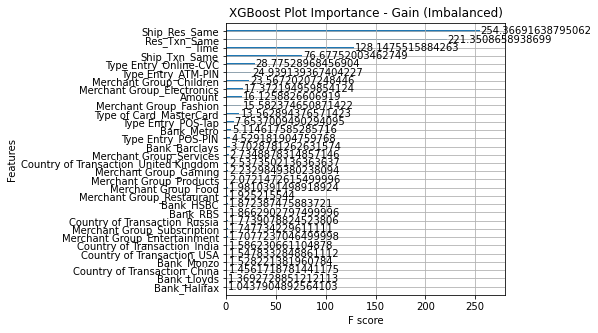

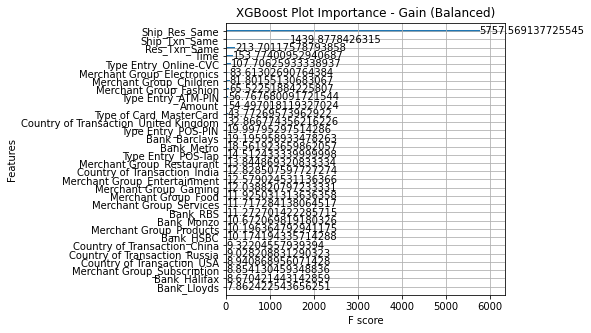

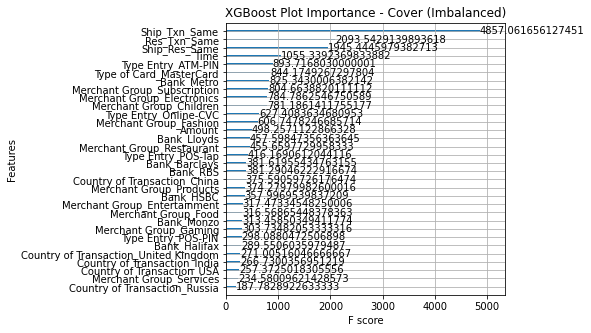

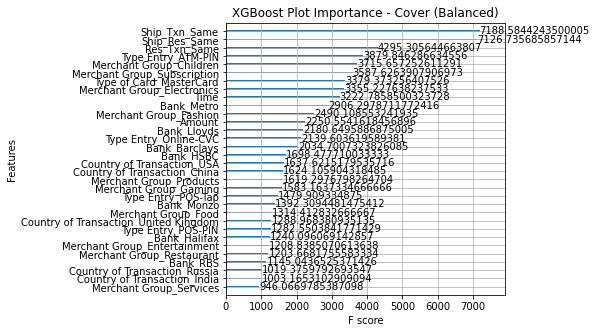

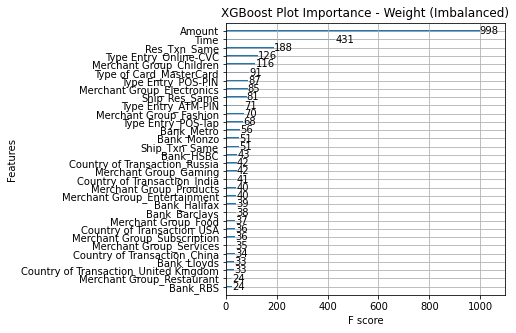

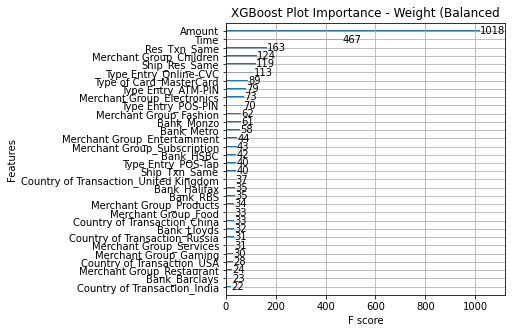

In [198]:
import xgboost

# Plots show average training loss reduction when feature is used in split
xgboost.plot_importance(xgb, importance_type='gain')
plt.title("XGBoost Plot Importance - Gain (Imbalanced)")
plt.rcParams['figure.figsize'] = [5, 5]
plt.show()

xgboost.plot_importance(xgb2, importance_type='gain')
plt.title("XGBoost Plot Importance - Gain (Balanced)")
plt.rcParams['figure.figsize'] = [5, 5]
plt.show()

# Plots show number of times feature is used to split data across trees weighted by training datapoints
xgboost.plot_importance(xgb, importance_type='cover')
plt.title("XGBoost Plot Importance - Cover (Imbalanced)")
plt.rcParams['figure.figsize'] = [5, 5]
plt.show()

xgboost.plot_importance(xgb2, importance_type='cover')
plt.title("XGBoost Plot Importance - Cover (Balanced)")
plt.rcParams['figure.figsize'] = [5, 5]
plt.show()

# Plots show number of times feature is used to split data across all trees
xgboost.plot_importance(xgb)
plt.title("XGBoost Plot Importance - Weight (Imbalanced)")
plt.rcParams['figure.figsize'] = [5, 5]
plt.show()

xgboost.plot_importance(xgb2)
plt.title("XGBoost Plot Importance - Weight (Balanced")
plt.rcParams['figure.figsize'] = [5, 5]
plt.show()

6.1.3: These plots show that predictive variables are where Shipping/Residential/Transaction countries differ. Time, Online transaction types, Children's Merchant category and Amount are also important.

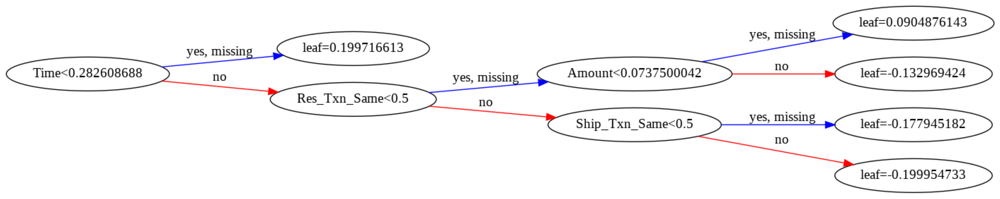

In [210]:
# Visualising first tree from imbalanced model.
from xgboost import plot_tree

plot_tree(xgb, num_trees=0, rankdir='LR')
plt.rcParams['figure.figsize'] = [50, 10]
plt.show()


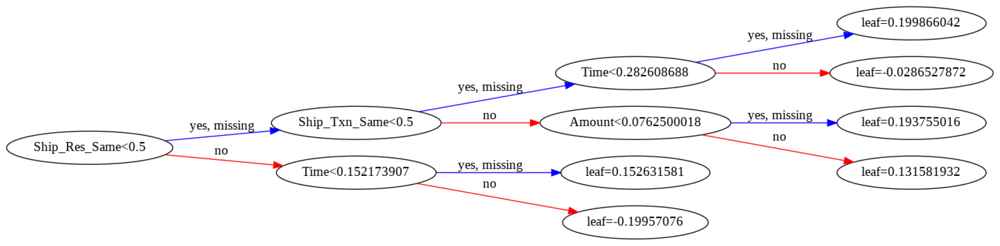

In [201]:
# Visualising first tree from balanced model.
from xgboost import plot_tree

plot_tree(xgb2, num_trees=0, rankdir='LR')
plt.rcParams['figure.figsize'] = [50, 10]
plt.show()

6.1.4: Similar variables are present in the first tree of the ensemble for each model but in different orders. 

# <font color='orange'> 7: Back Matter</font>

### 7.1: References

Aurélien Géron (2019). Hands-on machine learning with Scikit-Learn and TensorFlow concepts, tools, and techniques to build intelligent systems. O’Reilly Media, Inc., p.96.

Baak, M., Koopman, R., Snoek, H. and Klous, S. (2019). A new correlation coefficient between categorical, ordinal and interval variables with Pearson characteristics. arXiv:1811.11440 [stat]. [online] Available at: https://arxiv.org/abs/1811.11440.

Data Science Stack Exchange. (2018). scikit learn - When to use One Hot Encoding vs LabelEncoder vs DictVectorizor? [online] Available at: https://datascience.stackexchange.com/questions/9443/when-to-use-one-hot-encoding-vs-labelencoder-vs-dictvectorizor [Accessed 20 Jun. 2022].

Koo Ping Shung (2018). Accuracy, Precision, Recall or F1? [online] Towards Data Science. Available at: https://towardsdatascience.com/accuracy-precision-recall-or-f1-331fb37c5cb9 [Accessed 20 Jun. 2022].Kumar, A. (2021). Bagging Classifier Python Code Example. [online] Data Analytics. Available at: https://vitalflux.com/bagging-classifier-python-code-example/ [Accessed 20 Jun. 2022].

Lund, B. (2016). Weight of Evidence Coding and Binning of Predictors in Logistic Regression. [online] Mid west SAS Users Group. Available at: https://www.mwsug.org/proceedings/2016/AA/MWSUG-2016-AA15.pdf [Accessed 19 Jun. 2022].

Lutz, M. (2018). Learning Python. Sebastopol, Ca: O’reilly, p.xxxiii.Mahto, K.K. (2019). One-Hot-Encoding, Multicollinearity and the Dummy Variable Trap. [online] Medium. Available at: https://towardsdatascience.com/one-hot-encoding-multicollinearity-and-the-dummy-variable-trap-b5840be3c41a [Accessed 19 Jun. 2022].

Pedregosa, F., Varoquaux, G., Gramfort, A., Michel, V., Thirion, B., Grisel, O., Blondel, M., Prettenhofer, P., Weiss, R., Dubourg, V., Vanderplas, J., Passos, A., Cournapeau, D., Brucher, M., Perrot, M. and Duchesnay, É. (2011). Scikit-learn: Machine Learning in Python. Journal of Machine Learning Research, [online] 12(85), pp.2825–2830. Available at: https://jmlr.csail.mit.edu/papers/v12/pedregosa11a.html.Solon, 

G., Haider, S. and Wooldridge, J. (2013). WHAT ARE WE WEIGHTING FOR? [online] Available at: https://www.nber.org/system/files/working_papers/w18859/w18859.pdf [Accessed 20 Jun. 2022].

Tensorflow (n.d.). Classification on imbalanced data | TensorFlow Core. [online] TensorFlow. Available at: https://www.tensorflow.org/tutorials/structured_data/imbalanced_data [Accessed 21 Jun. 2022].

Veronica, A. (2020). Understanding Adaboost and Scikit-learn’s algorithm: [online] Medium. Available at: https://medium.datadriveninvestor.com/understanding-adaboost-and-scikit-learns-algorithm-c8d8af5ace10 [Accessed 20 Jun. 2022].

Wu, S. (2021). Is Normal Distribution Necessary in Regression? How to track and fix it? [online] Medium. Available at: https://towardsdatascience.com/is-normal-distribution-necessary-in-regression-how-to-track-and-fix-it-494105bc50dd [Accessed 20 Jun. 2022].

Zammito, F. (2019). What’s considered a good Log Loss in Machine Learning ? [online] Medium. Available at: https://medium.com/@fzammito/whats-considered-a-good-log-loss-in-machine-learning-a529d400632d [Accessed 20 Jun. 2022].